In [101]:
%run zip_pinns.py "pinns" "inv_pendulum.ipynb"

Directory 'pinns' and 'main.ipynb' have been zipped into '/app/stefanofelli/Consensus_PINNs/files.zip'.


In [2]:
%load_ext autoreload
%autoreload 2
from pinns.model import PINN, init_normal
from pinns.train import *
from pinns.gradient import jacobian
from pinns.dataset import DomainDataset, ValidationDataset
from consensus.simulate_inv_pendulum import initialize_inv_pendulum_states, simulate_network, plot_convergence_theta, plot_convergence_omega, plot_inv_pendulum_control
from consensus.network import *
from scipy.integrate import solve_ivp
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import imageio
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import plotly.graph_objects as go
import kaleido
import numpy as np
import skopt
from skopt import gp_minimize
from skopt.plots import plot_convergence, plot_objective
from skopt.space import Real, Categorical, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
import zipfile
from mpl_toolkits.mplot3d import Axes3D
from scipy.io import savemat

In [3]:
# Parameters for dynamics
G = 9.81     # gravity
L = 0.5      # length of the pole
m = 0.15     # ball mass
b = 0.1      # friction
J = m * L**2 # Inertia  
Q = 5.0      # constraint dVdx < -Q

def hard_constraint(x, y):
    '''
    Function to enforce hard constraints (For finding V(x), u(x))
    if x=0 => V(0)=0 (& dVdt(0)=0 => for a small neighborhood around zero of dVdt>-Q)
    Proved that returns multiplications x_j * y_j for eac j= 1,...,batchsize
    '''
    norm_x = torch.norm(x, p=2, dim=1, keepdim=True)
    V = norm_x * y[:, 0:1]
    u = y[:, 1:]
    constrained_y = torch.cat((V, u), dim=1)
    return constrained_y

def hard_constraint_alpha(x, y):
    '''
    Function to enforce hard constraints (For checking optimality of the chosen alpha)
    Modified such that V(x) is always positive
    '''
    norm_x = torch.norm(x, p=2, dim=1, keepdim=True)
    V = abs(norm_x * y[:, 0:1])
    u = y[:, 1:]
    constrained_y = torch.cat((V, u), dim=1)
    return constrained_y
# Define the ODE function for the Lyapunov constraints
# Dynamics with equilibrium in (pi,0): need to define new states [theta_bar = theta - pi, omega_bar = omega]
# Define system [theta_bar_dot, omega_bar_dot]: Express theta as function of theta_bar: theta = theta_bar + pi
def inv_pendulum_ode(pred,x):
    device = pred.device
    # Compute dynamics
    dxdt = []
    for r in range(0,len(pred)): 
        theta = x[r][0]
        theta_dot = x[r][1]
        f = [ 
            theta_dot, 
            (-m*G*L*torch.sin(theta+np.pi) - b*theta_dot) / J
        ]
        dxdt.append(f)  
    dxdt = torch.tensor(dxdt, device=device)
    # Add control (pred[:,1]) to the dynamics
    dxdt[:,1] = dxdt[:,1] + (pred[:,1] / J)
    # Gradient: The first row of jacobian (i=0) contains the gradient of Lyapunov function wrt x=(x1,x2)
    dVdx = jacobian(pred, x, i=0)
    # Lie derivative
    lie = dVdx[:,0]*dxdt[:,0] + dVdx[:,1]*dxdt[:,1]
    #check_dimensions(x,pred,dxdt,lie)    
    return lie, dVdx[:,0]*dxdt[:,0], dVdx[:,1]*dxdt[:,1]
    
def check_dimensions(x,pred,dxdt,lie):
    x_cpu = x.cpu().detach().numpy()
    y_cpu = pred.cpu().detach().numpy()
    dyn_cpu = dxdt.cpu().detach().numpy()
    lie_cpu = lie.cpu().detach().numpy()
    print(f'state shape: {x_cpu.shape}. 1st sample: ({x[0][0].item()}, {x[0][1].item()})')
    print(f'pred shape:  {y_cpu.shape}. 1st sample: ({pred[0][0].item()}, {pred[0][1].item()})')
    print(f'dynam shape: {dyn_cpu.shape}. 1st sample: ({dxdt[0][0].item()}, {dxdt[0][1].item()})')
    print(f'ode shape:   {lie_cpu.shape}.   1st sample: {lie[0].item()}')
    #for i in range(x_cpu.shape[0]):
    #    print(f"x:{x_cpu[i]}; y:{y_cpu[i]}; ode:{lie_cpu[i]}")


In [4]:
# Parameters for dynamics
G = 9.81     # gravity
L = 0.5      # length of the pole
m = 0.15     # ball mass
b = 0.1      # friction
J = m * L**2 # Inertia  
Q = 5.0      # constraint dVdx < -Q

def hard_constraint(x, y):
    '''
    Function to enforce hard constraints (For finding V(x), u(x))
    if x=0 => V(0)=0 (& dVdt(0)=0 => for a small neighborhood around zero of dVdt>-Q)
    Proved that returns multiplications x_j * y_j for eac j= 1,...,batchsize
    '''
    norm_x = torch.norm(x, p=2, dim=1, keepdim=True)
    V = norm_x * y[:, 0:1]
    u = y[:, 1:]
    constrained_y = torch.cat((V, u), dim=1)
    return constrained_y

def hard_constraint_alpha(x, y):
    '''
    Function to enforce hard constraints (For checking optimality of the chosen alpha)
    Modified such that V(x) is always positive
    '''
    norm_x = torch.norm(x, p=2, dim=1, keepdim=True)
    V = abs(norm_x * y[:, 0:1])
    u = y[:, 1:]
    constrained_y = torch.cat((V, u), dim=1)
    return constrained_y

# Parameter optimization

Starting call 1 with config: [0.0001, 10, 500, 'relu', 3.0, 1.0, 0.0001]


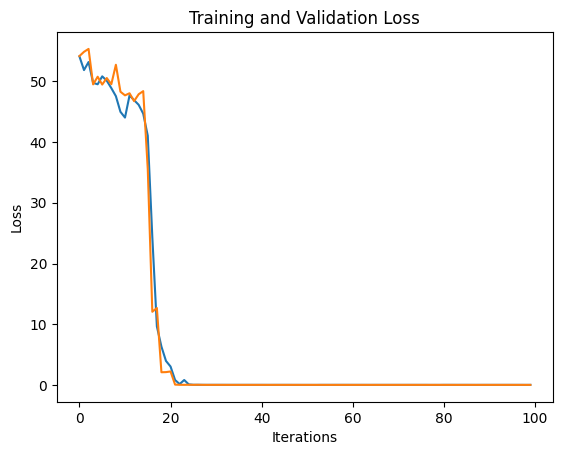

Starting call 2 with config: [0.001559245358901932, 13, 687, 'sigmoid', 6.2732805981811275, 3.9053789021977297, 2.9754163119840693]


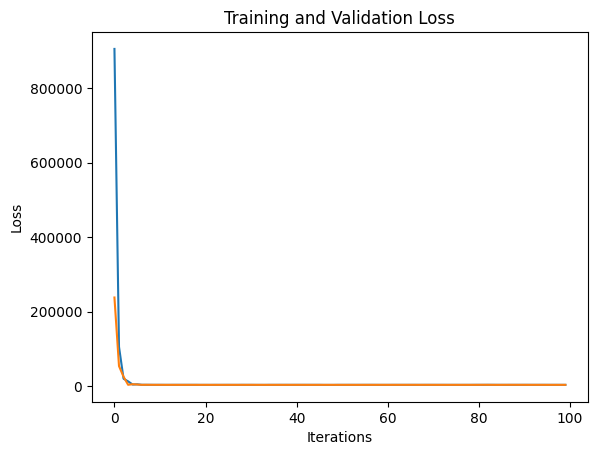

Starting call 3 with config: [1.6209872614532136e-05, 5, 385, 'sigmoid', 4.851774006513068, 3.9885694813982155, 8.360804027497423]


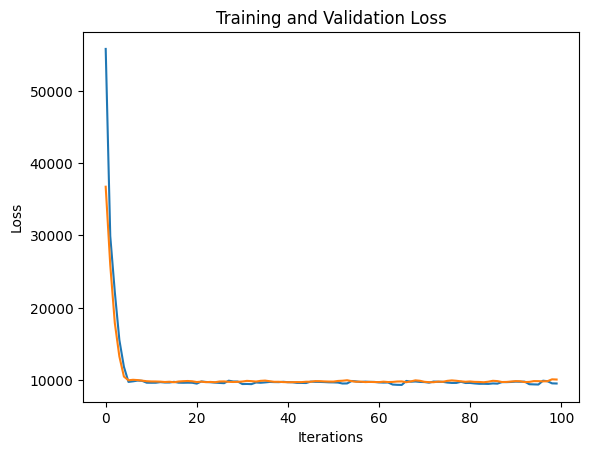

Starting call 4 with config: [0.00017701834536094652, 10, 298, 'sigmoid', 1.4894727260851874, 8.713863857748523, 4.736133091932579]


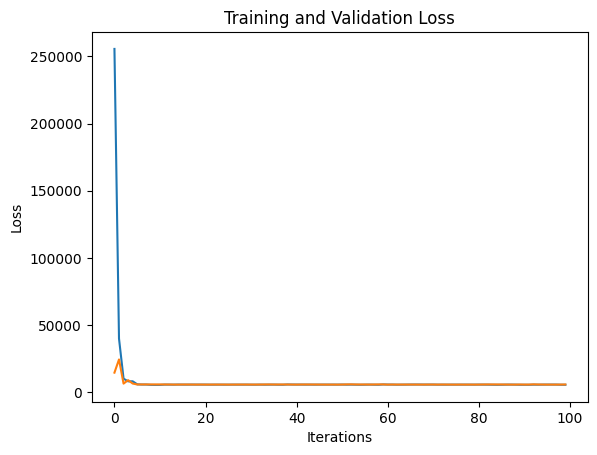

Starting call 5 with config: [0.009173706634207076, 8, 545, 'sigmoid', 5.861995941543562, 5.419994971545207, 7.5861803816611415]


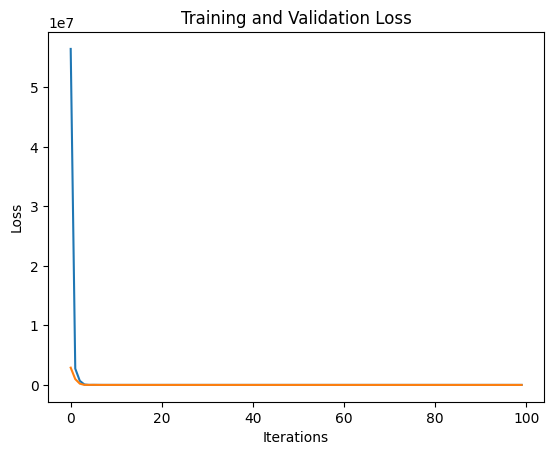

Starting call 6 with config: [2.4646148574845566e-05, 8, 153, 'sigmoid', 2.2438485088012823, 1.4386599167139758, 3.2414776638313625]


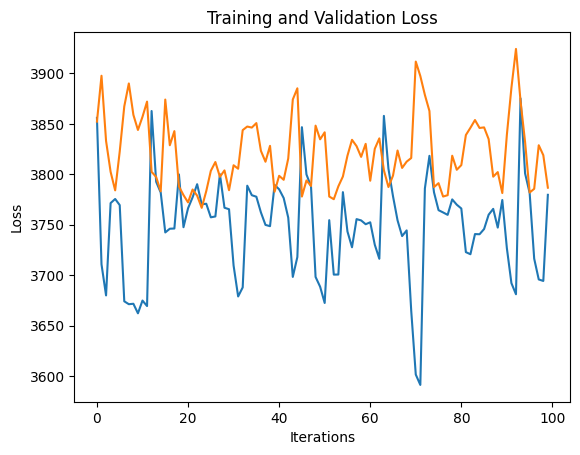

Starting call 7 with config: [3.578020661637384e-05, 4, 312, 'sigmoid', 4.554504900121154, 6.169328233052912, 9.023495596881528]


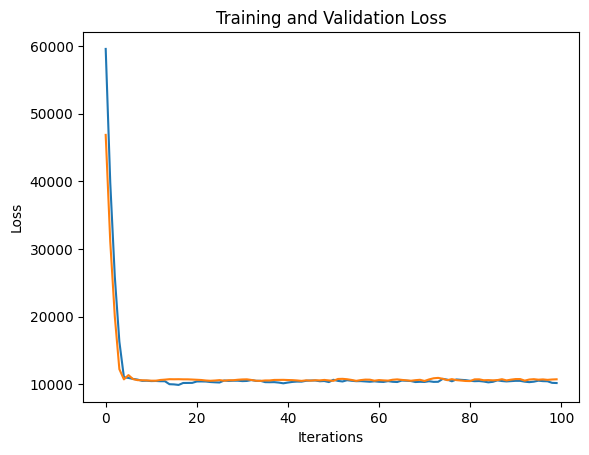

Starting call 8 with config: [2.329351549991238e-05, 15, 524, 'relu', 3.6457064529982985, 7.531792798062718, 6.078345904087807]


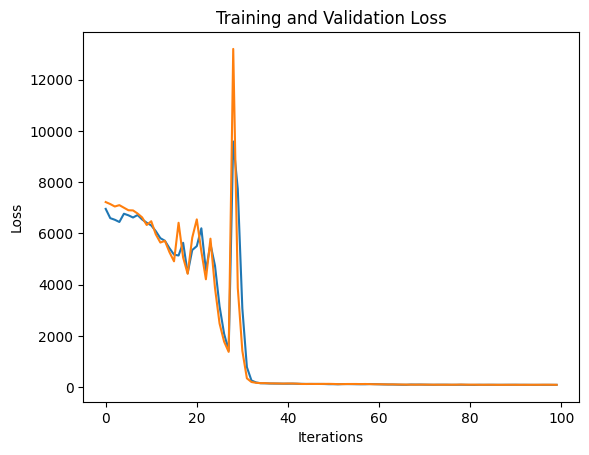

Starting call 9 with config: [0.00015934555386707118, 2, 509, 'sigmoid', 6.56262413835436, 6.387082848675283, 9.95299614682211]


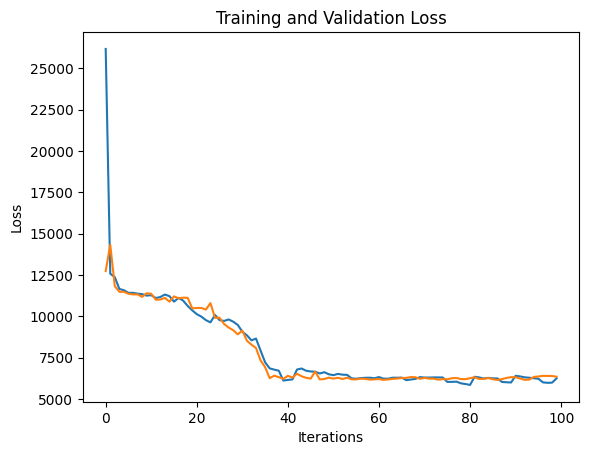

Starting call 10 with config: [0.0014198645479973132, 7, 382, 'tanh', 3.446275386905029, 6.780047990364306, 3.1720857005187546]


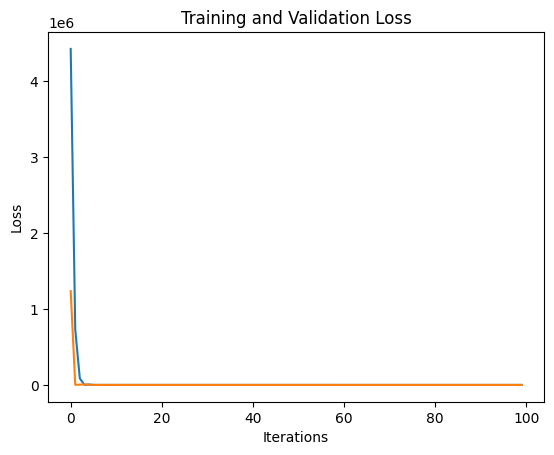

Starting call 11 with config: [0.007569663798355117, 14, 532, 'relu', 6.2661763459120285, 6.769230345274316, 9.71945283049641]


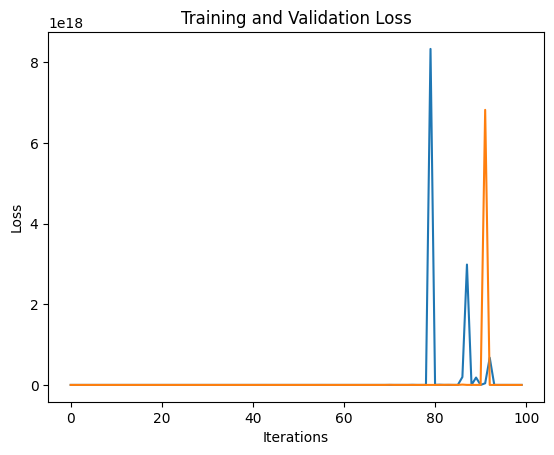

Starting call 12 with config: [0.049999999999999996, 15, 800, 'sigmoid', 10.0, 0.1, 0.0001]


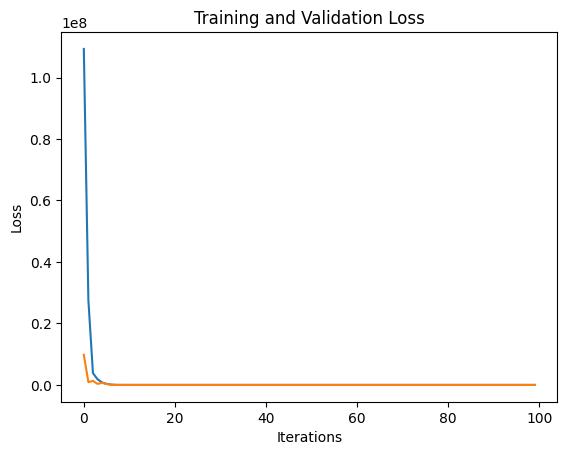

Starting call 13 with config: [5.129552594877751e-05, 1, 5, 'relu', 0.1, 0.1, 0.0001]


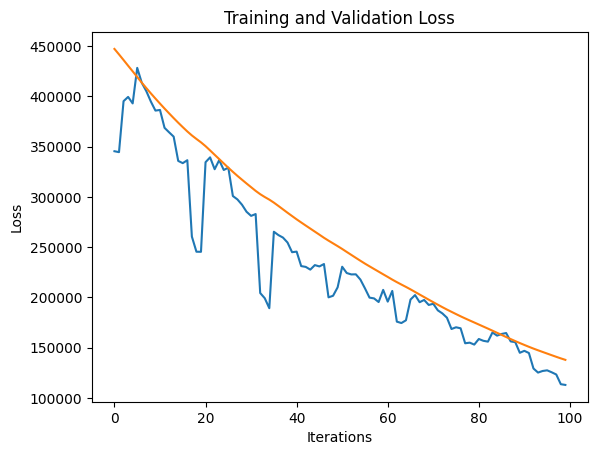

Starting call 14 with config: [1e-05, 15, 800, 'relu', 10.0, 0.1, 0.0001]


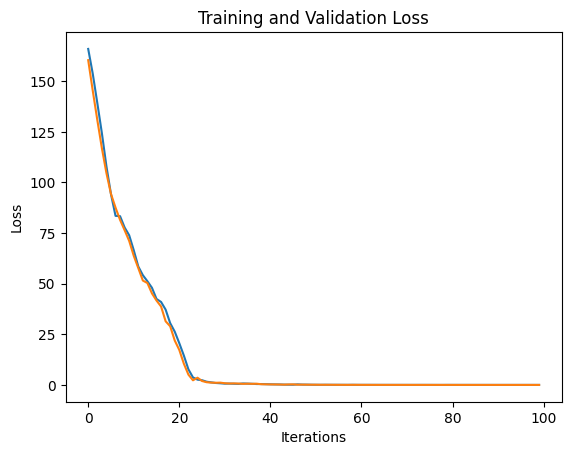

Starting call 15 with config: [6.773391863741776e-05, 15, 800, 'relu', 10.0, 10.0, 10.0]


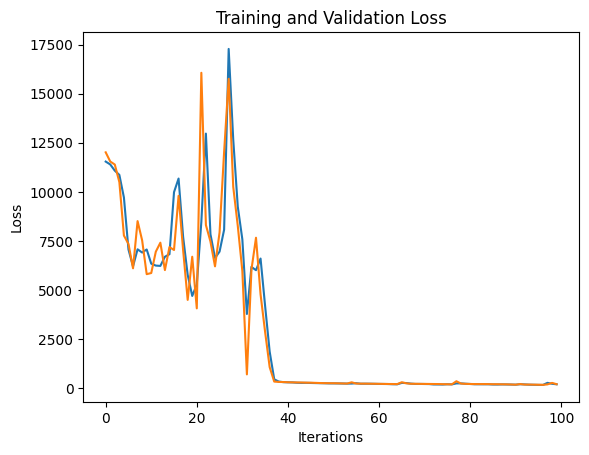

Starting call 16 with config: [1e-05, 15, 800, 'tanh', 10.0, 0.1, 10.0]


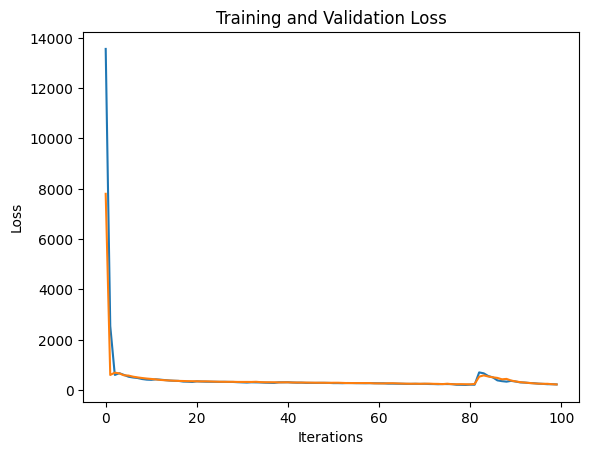

Starting call 17 with config: [0.0005229586086950226, 1, 800, 'sigmoid', 10.0, 0.1, 10.0]


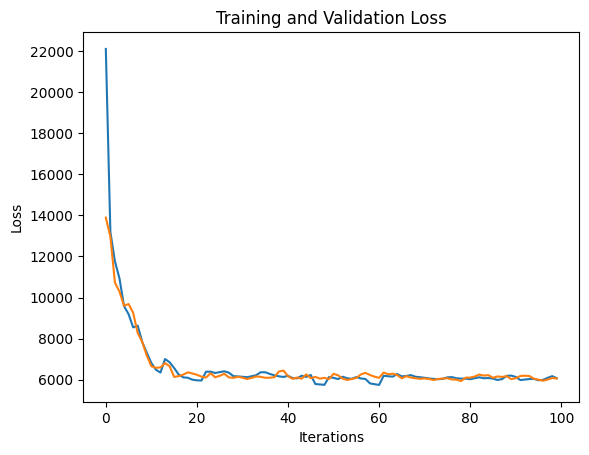

Starting call 18 with config: [0.024434790546290455, 15, 5, 'tanh', 0.1, 10.0, 10.0]


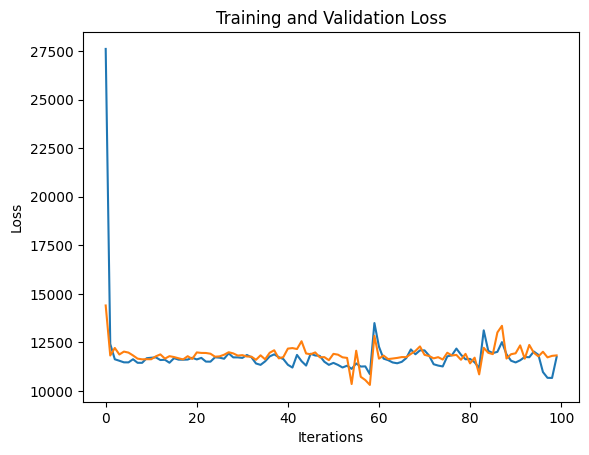

Starting call 19 with config: [0.003907509399105401, 15, 5, 'tanh', 10.0, 0.1, 10.0]


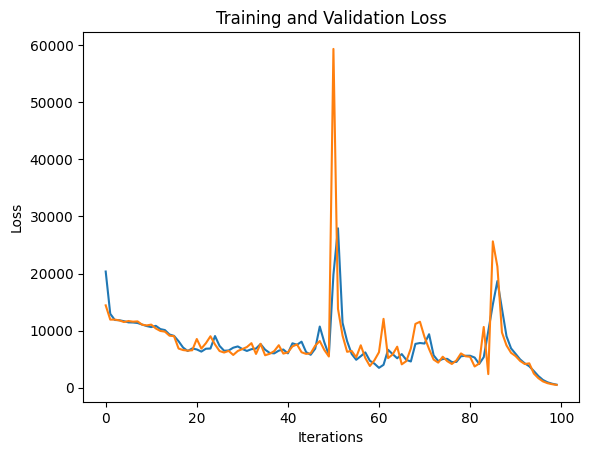

Starting call 20 with config: [1e-05, 1, 5, 'sigmoid', 0.1, 10.0, 0.0001]


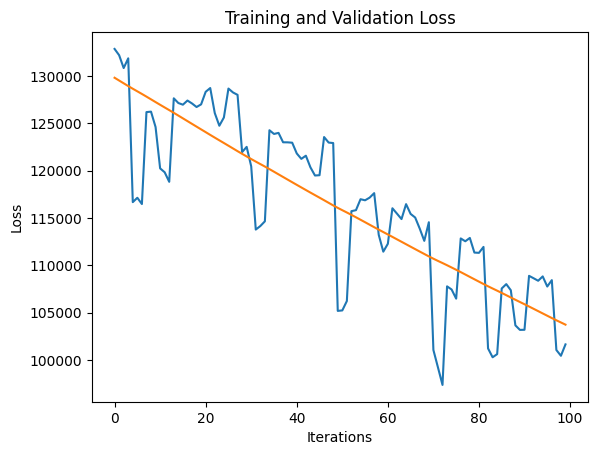

Starting call 21 with config: [7.174779839525704e-05, 15, 800, 'relu', 0.1, 0.1, 0.0001]


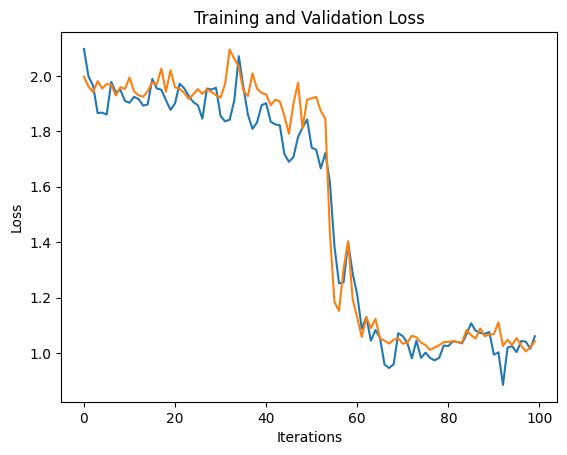

Starting call 22 with config: [1e-05, 1, 5, 'relu', 0.1, 10.0, 10.0]


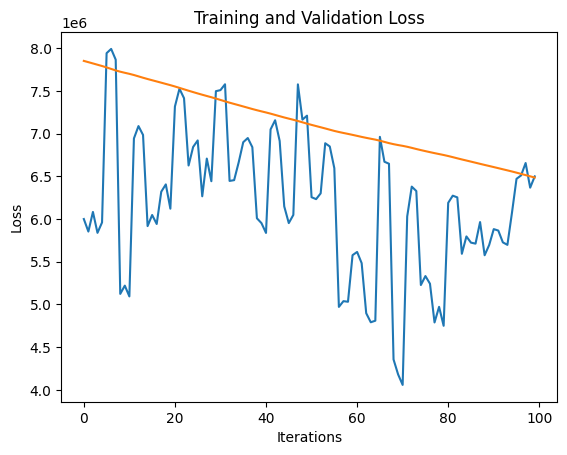

Starting call 23 with config: [7.918514341286948e-05, 15, 800, 'tanh', 0.1, 0.1, 0.0001]


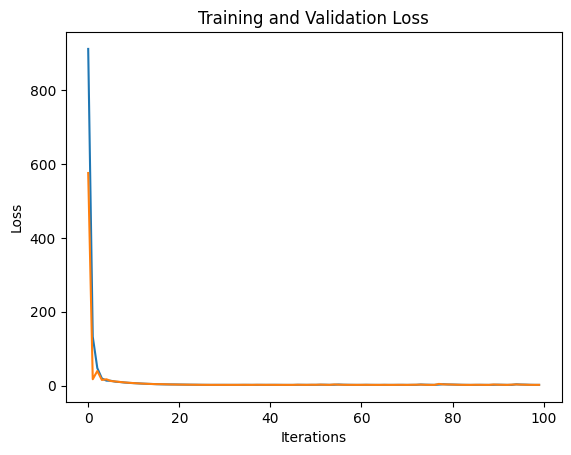

Starting call 24 with config: [0.049999999999999996, 1, 5, 'sigmoid', 0.1, 10.0, 10.0]


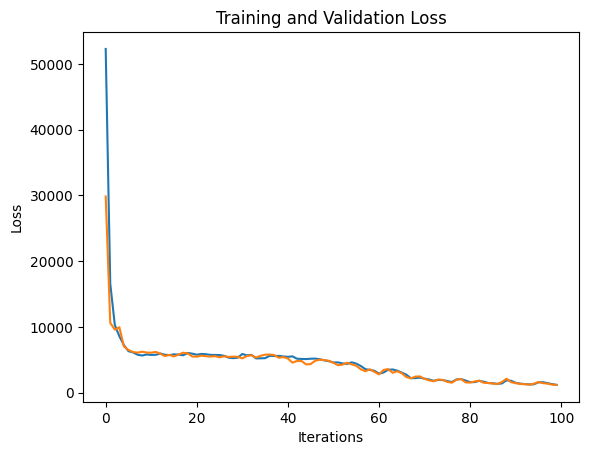

Starting call 25 with config: [1.5920856868734445e-05, 1, 5, 'relu', 10.0, 10.0, 0.0001]


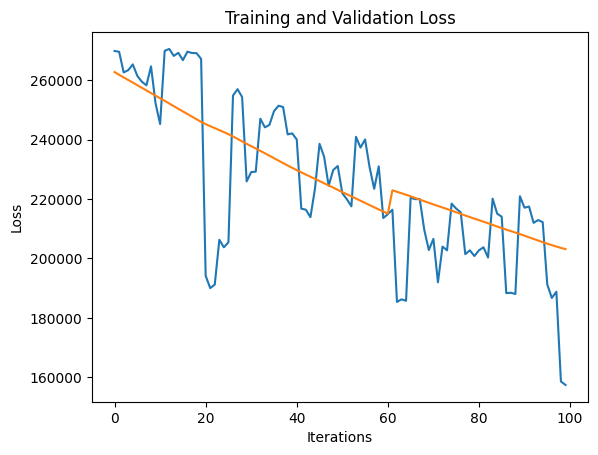

Starting call 26 with config: [0.024041323096925568, 1, 5, 'sigmoid', 10.0, 0.1, 0.0001]


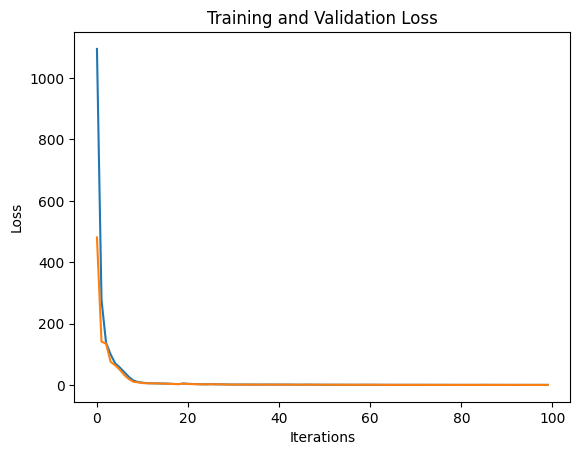

Starting call 27 with config: [0.0036781558471396334, 1, 800, 'sigmoid', 0.1, 10.0, 0.0001]


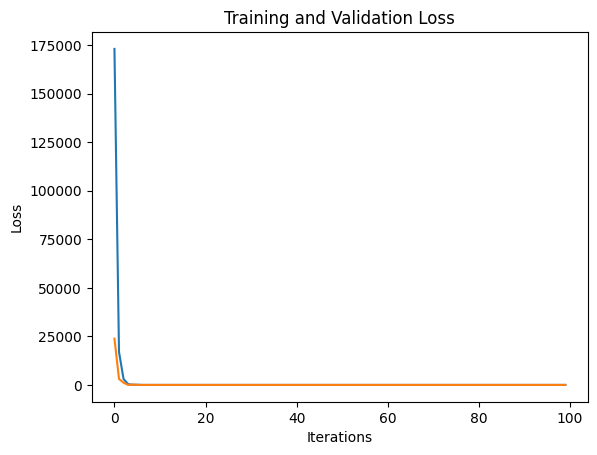

Starting call 28 with config: [2.063260322440088e-05, 1, 5, 'tanh', 10.0, 10.0, 0.0001]


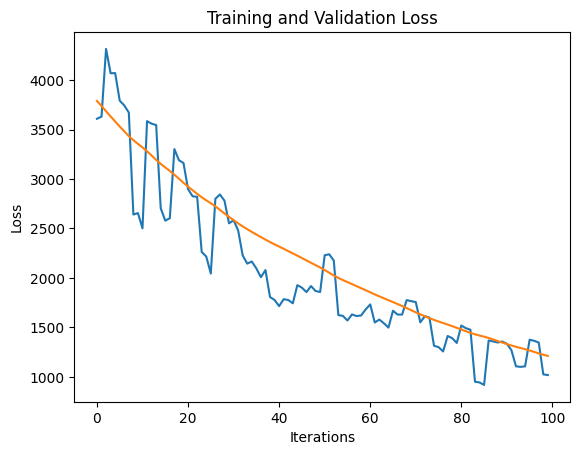

Starting call 29 with config: [8.212416710491442e-05, 1, 5, 'relu', 10.0, 0.1, 10.0]


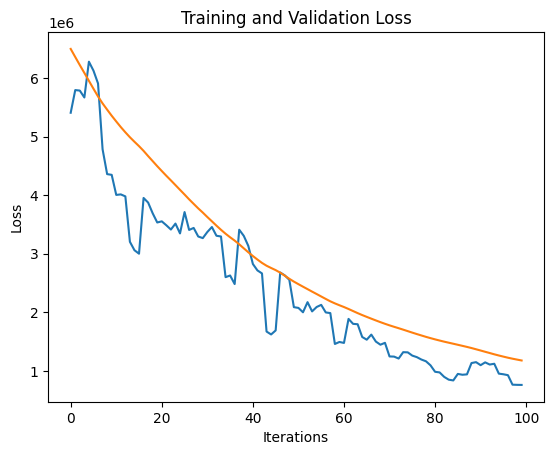

Starting call 30 with config: [8.246178538534338e-05, 15, 5, 'relu', 0.1, 10.0, 0.0001]


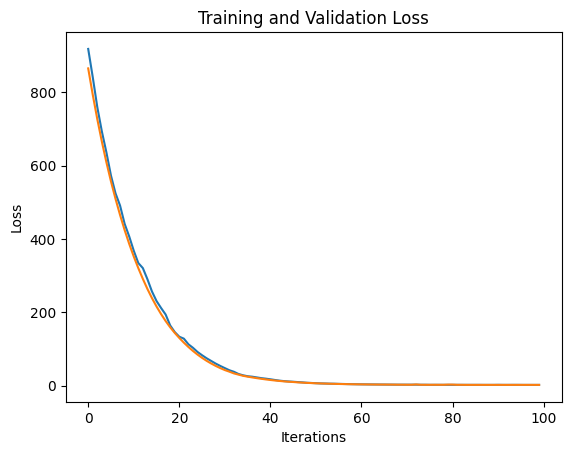

Starting call 31 with config: [0.00028248319114482353, 15, 800, 'tanh', 10.0, 0.1, 0.0001]


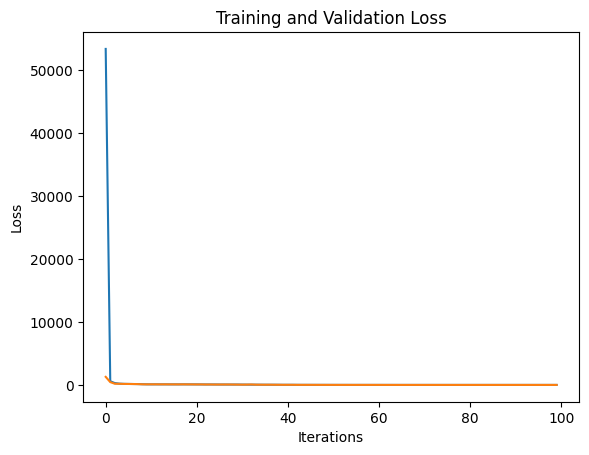

Starting call 32 with config: [0.049999999999999996, 1, 800, 'tanh', 10.0, 10.0, 0.0001]


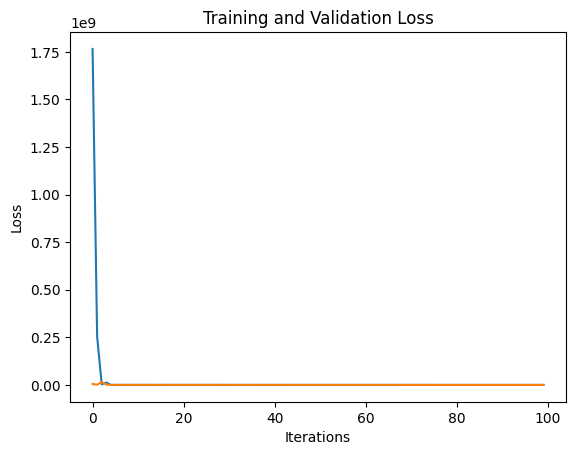

Starting call 33 with config: [0.0007895379217661894, 15, 5, 'sigmoid', 10.0, 10.0, 0.0001]


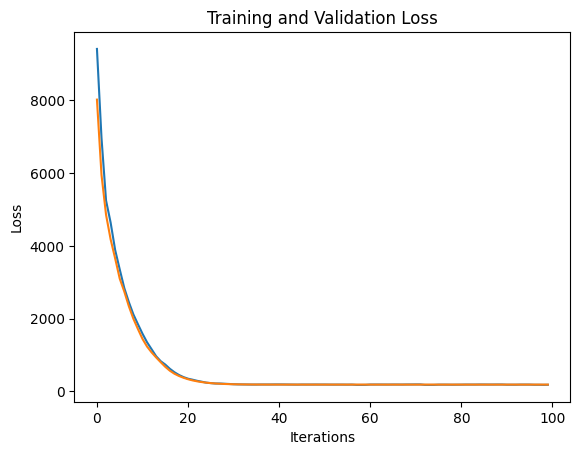

Starting call 34 with config: [8.392680111743591e-05, 1, 800, 'relu', 10.0, 10.0, 0.0001]


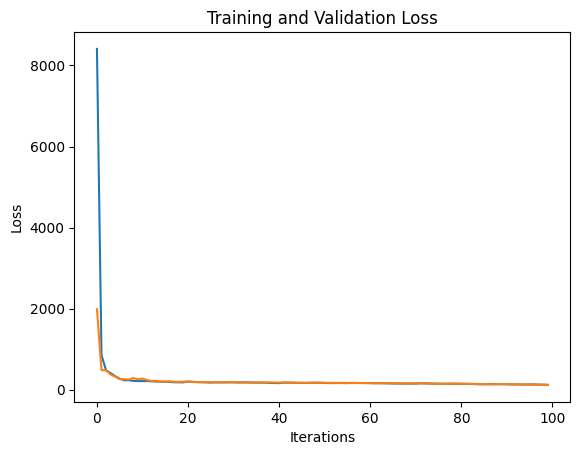

Starting call 35 with config: [0.012634065421119806, 1, 5, 'tanh', 0.1, 0.1, 0.0001]


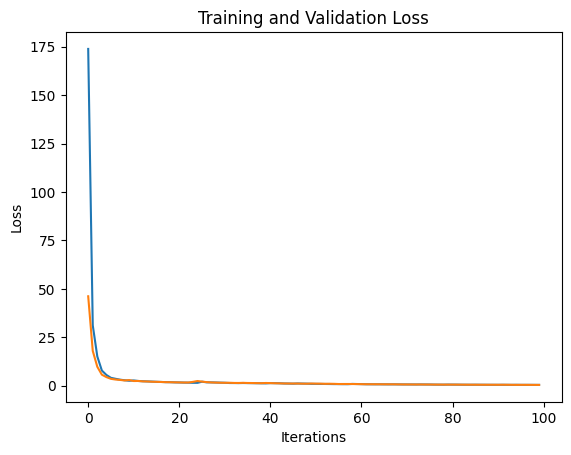

Starting call 36 with config: [6.732907196733829e-05, 1, 5, 'sigmoid', 10.0, 0.1, 0.0001]


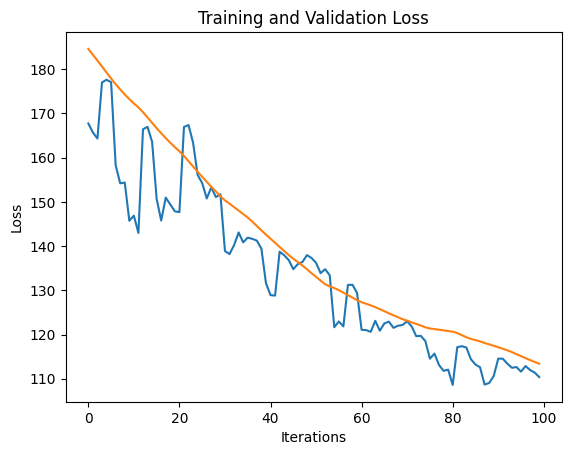

Starting call 37 with config: [0.035318206487446116, 1, 800, 'tanh', 0.1, 0.1, 10.0]


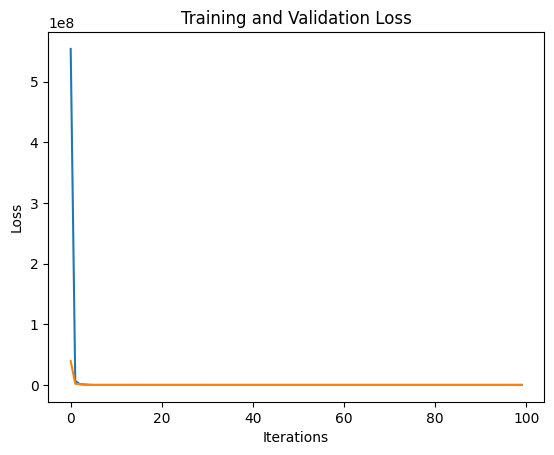

Starting call 38 with config: [0.0002950603071297249, 1, 5, 'tanh', 0.1, 0.1, 10.0]


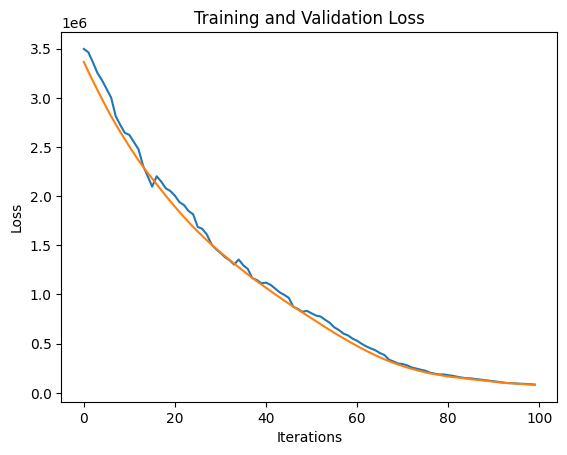

Starting call 39 with config: [9.587382671469161e-05, 15, 5, 'tanh', 10.0, 10.0, 10.0]


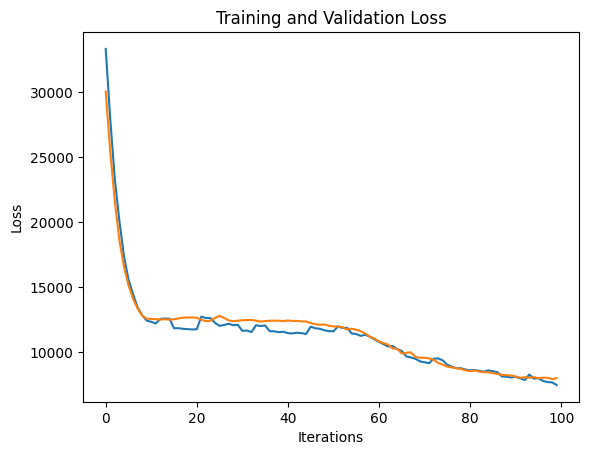

Starting call 40 with config: [0.016357177821830625, 1, 800, 'sigmoid', 10.0, 10.0, 10.0]


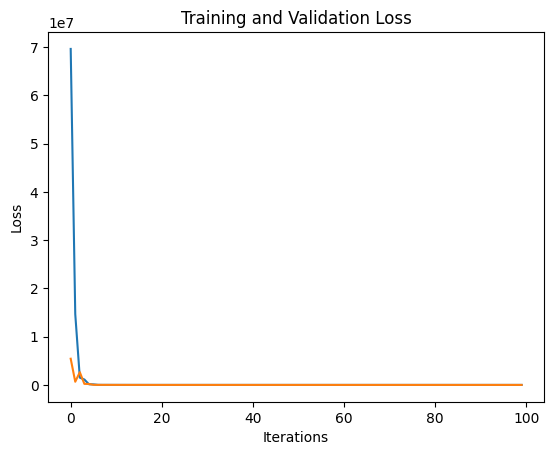

Starting call 41 with config: [1e-05, 15, 506, 'relu', 4.577138779877799, 0.1, 1.1743644449387178]


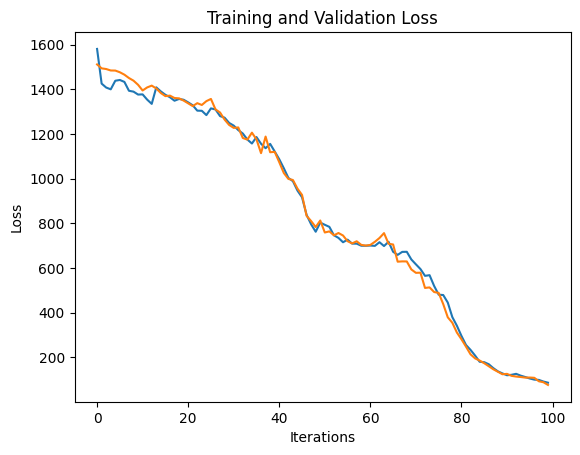

Starting call 42 with config: [0.0008449045026683415, 15, 800, 'tanh', 0.1, 0.1, 10.0]


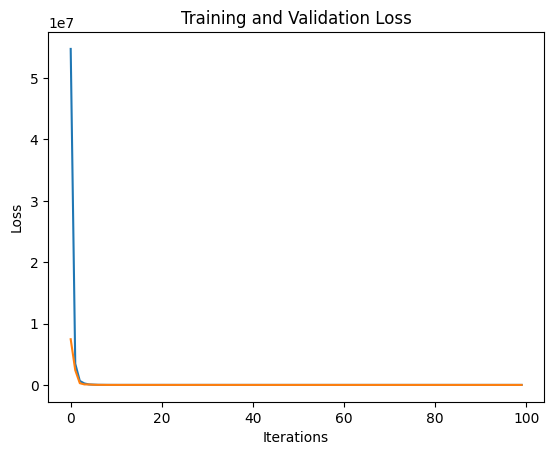

Starting call 43 with config: [3.4261332275970596e-05, 15, 5, 'relu', 10.0, 0.1, 0.0001]


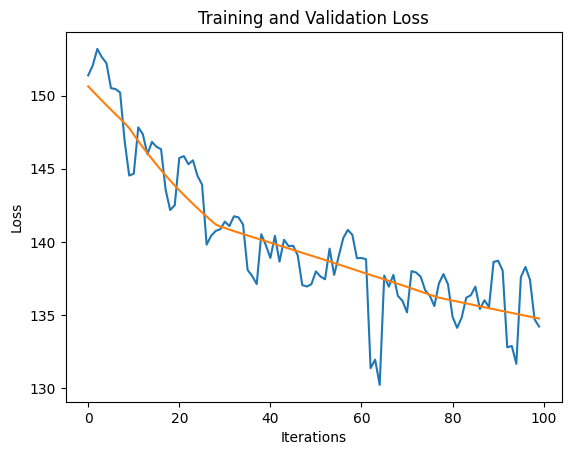

Starting call 44 with config: [0.049999999999999996, 15, 5, 'tanh', 10.0, 0.1, 10.0]


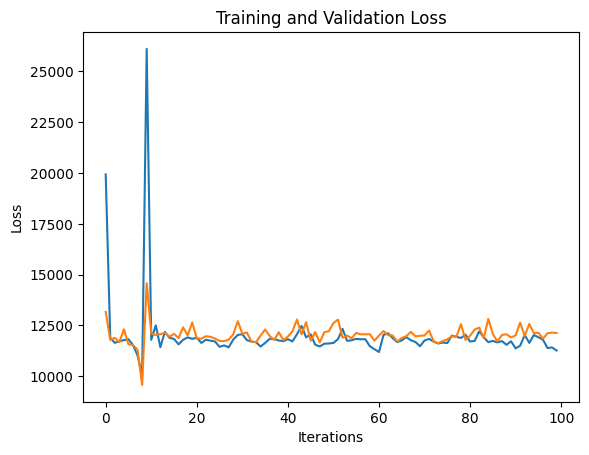

Starting call 45 with config: [1.3009320125938455e-05, 7, 519, 'relu', 8.52242960713732, 8.859372671952764, 5.368583003061364]


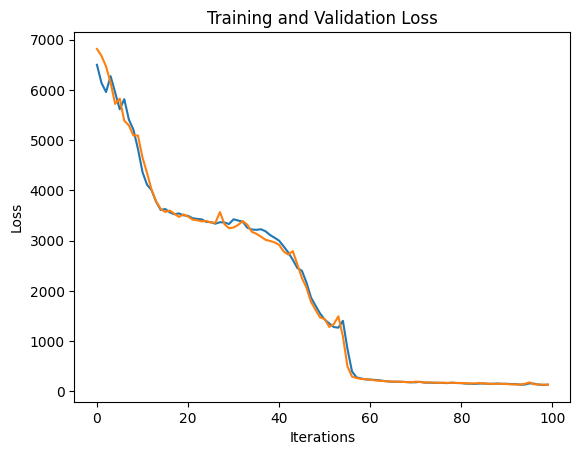

Starting call 46 with config: [1e-05, 1, 5, 'tanh', 0.1, 0.1, 10.0]


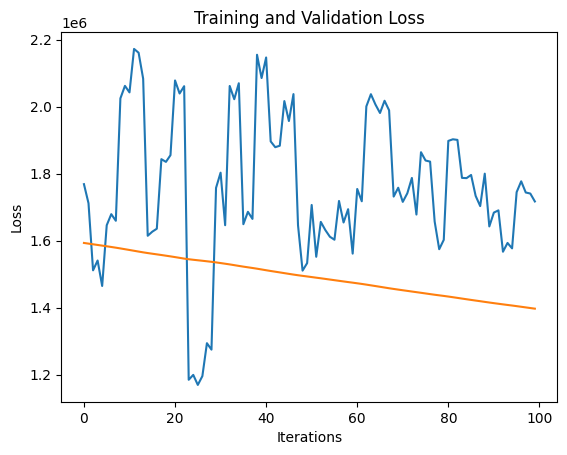

Starting call 47 with config: [0.0061169222522957775, 15, 800, 'tanh', 10.0, 10.0, 0.0001]


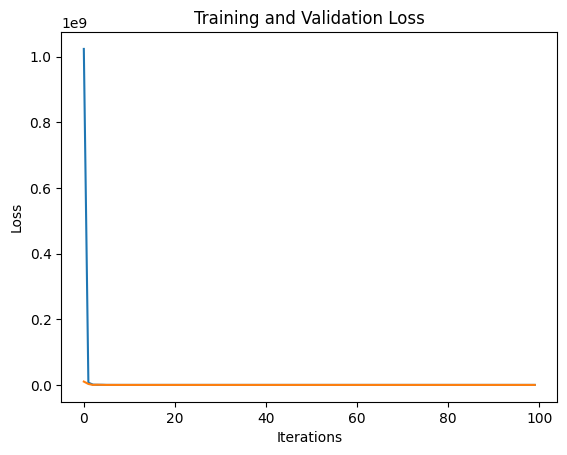

Starting call 48 with config: [1.3322011332305683e-05, 15, 800, 'tanh', 0.1, 10.0, 0.0001]


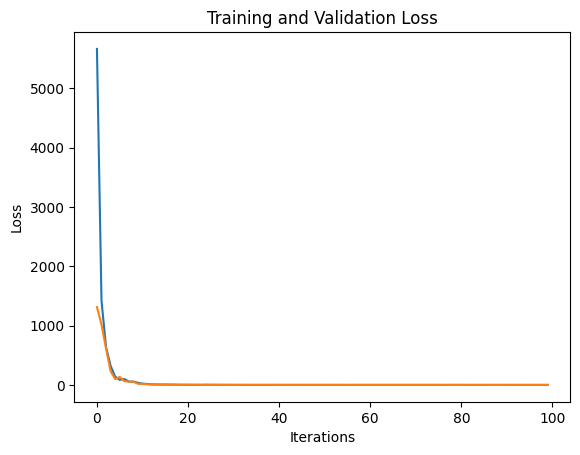

Starting call 49 with config: [0.00037465180814597016, 15, 800, 'sigmoid', 0.1, 10.0, 10.0]


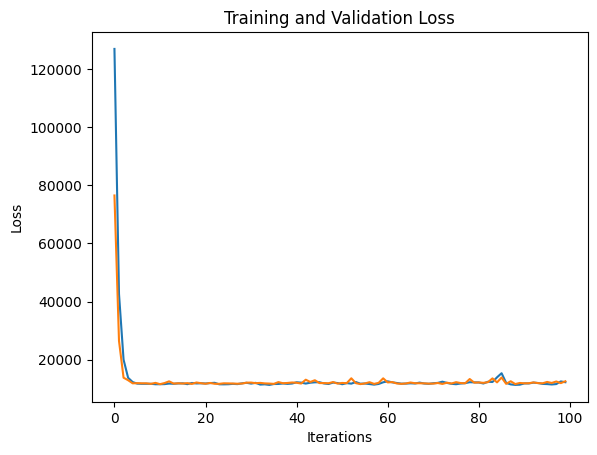

Starting call 50 with config: [0.0023870229629901806, 15, 800, 'tanh', 10.0, 10.0, 10.0]


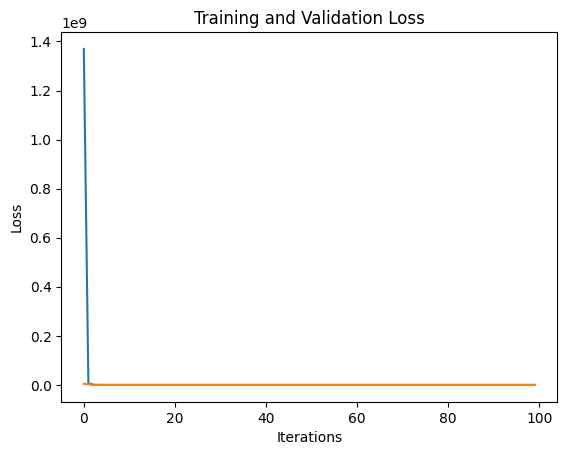

Best hyper-parameters found:  [0.0001, 10, 500, 'relu', 3.0, 1.0, 0.0001]


In [114]:
# Functions 
## Define the training function
def train_model(model, optimizer, config):
    learning_rate, num_dense_layers, num_dense_nodes, activation, positive_w, derivative_w, properness_w = config
    train_data = {
        "name": "Inv_pend_PINN",
        "model": model,
        "epochs": 100,  
        "batchsize": 1024, 
        "optimizer": optimizer,
        "scheduler_step": None,
        "scheduler_reduce": None,
        "ode_fn": inv_pendulum_ode,
        "domain_dataset": domainDataset,
        "validation_domain_dataset": validationDataset,
        "Q": Q,
        "positive_w": positive_w,
        "derivative_w": derivative_w,
        "properness_w": properness_w,
        "normalization": False
    }
    return train_param_opt(train_data)
    
## Define the model creation function
def create_model(config):
    learning_rate, num_dense_layers, num_dense_nodes, activation = config[:4]
    activation_function = activation_functions[activation.lower()]

    model = PINN(
        layers=[num_inputs] + [num_dense_nodes] * num_dense_layers + [num_outputs],
        activation_function=activation_function,
        hard_constraint_fn=hard_constraint
    ).to(torch.device('cuda:0'))
    model = model.apply(init_normal)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    return model, optimizer

# Search Space and Default Parameters:
activation_functions = {
    "relu": nn.ReLU,
    "tanh": nn.Tanh,
    "sigmoid": nn.Sigmoid
}
dim_learning_rate = Real(low=1e-5, high=5e-2, name="learning_rate", prior="log-uniform")
dim_num_dense_layers = Integer(low=1, high=15, name="num_dense_layers")
dim_num_dense_nodes = Integer(low=5, high=800, name="num_dense_nodes")
dim_activation = Categorical(categories=["relu", "tanh", "sigmoid"], name="activation")
dim_positive_w = Real(low=0.1, high=10.0, name="positive_w")
dim_derivative_w = Real(low=0.1, high=10.0, name="derivative_w")
dim_properness_w = Real(low=0.0001, high=10.0, name="properness_w")
dimensions = [
    dim_learning_rate,
    dim_num_dense_layers,
    dim_num_dense_nodes,
    dim_activation,
    dim_positive_w,
    dim_derivative_w,
    dim_properness_w
]
default_parameters = [0.0001, 10, 500, "relu", 3.0, 1.0, 0.0001]

# Run the hyper-parameter optimization
## Define the fitness function
call_counter = 0
@use_named_args(dimensions=dimensions)
def fitness(learning_rate, num_dense_layers, num_dense_nodes, activation, positive_w, derivative_w, properness_w):
    config = [learning_rate, num_dense_layers, num_dense_nodes, activation, positive_w, derivative_w, properness_w]
    global call_counter
    call_counter += 1
    print(f"Starting call {call_counter} with config: {config}")
    model, optimizer = create_model(config)
    error = train_model(model, optimizer, config)
    return error
## Find the result
res = gp_minimize(
    func=fitness,
    dimensions=dimensions,
    acq_func="EI",  # Expected Improvement
    n_calls=50,  # Number of trainings 
    x0=default_parameters,
    random_state=0
)

print("Best hyper-parameters found: ", res.x)


In [115]:
print(res.x)

[0.0001, 10, 500, 'relu', 3.0, 1.0, 0.0001]


# Find V(x) and u(x) for Inverse Pendulum

In [ ]:
# Hyperparameters
epochs = 300
num_inputs = 2  # samples x1 and x2 (theta and omega [theta_dot])
num_outputs = 2 # Lyapunov V(x1,x2) and control u(x1,x2)
batchsize = 1024
num_layers = 10
num_nodes = 500
act_fn = nn.ReLU
#learning_rate = 0.0002830155348870433
learning_rate = 0.0001

# Build datasets
print("Building Domain Dataset")
domainDataset = DomainDataset([-np.pi]*num_inputs,[np.pi]*num_inputs, 10000, period=3)
print("Building Validation Dataset")
validationDataset = ValidationDataset([-np.pi]*num_inputs,[np.pi]*num_inputs, batchsize)

# Initialize the model, with 2 outputs (Lyapunov Function and Control)
pendulum_model_1 = PINN([num_inputs] + [num_nodes]*num_layers + [num_outputs], act_fn, hard_constraint).to(torch.device('cuda:0'))
pendulum_model_1 = pendulum_model_1.apply(init_normal)
# Initialize the optimizer
optimizer = optim.Adam(pendulum_model_1.parameters(), lr=learning_rate)
scheduler_reduce = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2, factor=0.8)
scheduler_step = optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)

# Use the existing train function
train_data = {
    "name": "Inv_pend_PINN",
    "model": pendulum_model_1,
    "epochs": epochs,
    "batchsize": batchsize,
    "optimizer": optimizer,
    "scheduler_step": scheduler_step,
    "scheduler_reduce": None,
    "ode_fn": inv_pendulum_ode,
    "domain_dataset": domainDataset,
    "validation_domain_dataset": validationDataset,
    "Q": Q,
    "positive_w": 4.0,
    "derivative_w": 1.0,
    "properness_w": 0.000,
    "check_alpha": False    # Train PINN such that finds u(x)
}
# Train the model
train(train_data)

Building Domain Dataset
Building Validation Dataset
Learning rate: 0.0001
Epoch 1 	 Train Loss: 72.18312; 	 Valid Loss: Pos= 68.96012115478516, Deriv= 1.10515987873077, Prop= 0.00000000000000
Epoch 2 	 Train Loss: 66.37136; 	 Valid Loss: Pos= 60.28264999389648, Deriv= 4.54256439208984, Prop= 0.00000000000000
Epoch 3 	 Train Loss: 64.10674; 	 Valid Loss: Pos= 57.89022445678711, Deriv= 4.55573225021362, Prop= 0.00000000000000
Epoch 4 	 Train Loss: 63.70357; 	 Valid Loss: Pos= 53.53420257568359, Deriv= 10.11908531188965, Prop= 0.00000000000000
Epoch 5 	 Train Loss: 63.15865; 	 Valid Loss: Pos= 50.48493576049805, Deriv= 10.64338874816895, Prop= 0.00000000000000
Epoch 6 	 Train Loss: 64.67804; 	 Valid Loss: Pos= 50.93363952636719, Deriv= 14.14394187927246, Prop= 0.00000000000000
Epoch 7 	 Train Loss: 67.30196; 	 Valid Loss: Pos= 60.27146148681641, Deriv= 3.92442131042480, Prop= 0.00000000000000
Epoch 8 	 Train Loss: 64.70870; 	 Valid Loss: Pos= 52.76474761962891, Deriv= 8.34752655029297, Pr

In [1]:
load_model = False
figures_path = "figures/Inv_pend/Train_Leader_control/"
os.makedirs(figures_path, exist_ok=True)
# Generate a range of x1 and x2 values
x1_values = np.linspace(-np.pi, np.pi, 200)
#x1_values = np.linspace(0.0, 2*np.pi, 100)
x2_values = np.linspace(-np.pi, np.pi, 200)
x1_grid, x2_grid = np.meshgrid(x1_values, x2_values)
x_tensor = torch.tensor(np.column_stack((x2_grid.ravel(), x1_grid.ravel())), dtype=torch.float32, requires_grad=True).to('cuda:0')
x_0_tensor = torch.tensor([[0, 0]], dtype=torch.float32, requires_grad=True).to('cuda:0')

if load_model is True:
    num_training = "00"
    model_path = f'output/Inv_pend_PINN/Inv_pend_PINN_{num_training}/model/model.pt'
    loaded_model = torch.load(model_path)
    loaded_model.eval()
    output = loaded_model(x_tensor)
    output_0 = loaded_model(x_0_tensor)
else:
    output = pendulum_model_1(x_tensor)
    output_0 = pendulum_model_1(x_0_tensor)

# Compute Lyapunov function V(x) [1st output] and corresponding value in zero
V = output[:, 0].cpu().detach().numpy().reshape(x1_grid.shape)
print(f'V(0,0) = {output_0[:,0].item()}')
V_min = np.min(V)
V_max = np.max(V)
zero_plane = np.full_like(x1_grid, 0)

# Compute Analytical Lyapunov
V_tilde = 0.5 * J * x2_grid**2 + m * G * L * (1 - np.cos(x1_grid))
#V_tilde = m * G * L * (1 + np.cos(x1_grid)) + 0.5 * J * x2_grid**2 
# Compute Control input u [2nd output] and corresponding value in zero
control = output[:, 1].cpu().detach().numpy().reshape(x1_grid.shape)
print(f'u(0,0) = {output_0[:,1].item()}')

# Compute Lie derivative of V(x) and corresponding value in zero
V_dot, lie1, lie2 = inv_pendulum_ode(output, x_tensor)
V_dot = V_dot.cpu().detach().numpy().reshape(x1_grid.shape)
V_dot_0 = inv_pendulum_ode(output_0, x_0_tensor)
print(f'V_dot(0,0) = {V_dot_0[0].item()}')
V_dot_max = np.max(V_dot)
V_dot_min = np.min(V_dot)
V_dot_argmax = np.argmax(V_dot)
x1_maximum = x1_grid.ravel()[V_dot_argmax]
x2_maximum = x2_grid.ravel()[V_dot_argmax]
Q_plane = np.full_like(x1_grid, -Q)

# Save variables in .mat file
data = {
    'x1_grid': x1_grid,
    'x2_grid': x2_grid,
    'V': V,
    'V_tilde': V_tilde,
    'control': control,
    'V_dot': V_dot
}
savemat(f'{figures_path}inv_pendulum_data.mat', data)

# Plot the learned Lyapunov function (1st output) in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x1_grid+np.pi, x2_grid, V, cmap='viridis')#,label=f'Min($V(x(t))$)={output_0[:,0].item()}')
#ax.plot_surface(x1_grid, x2_grid, zero_plane, alpha=0.5, color='red')
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\omega$')
ax.set_zlabel(r'$V(\theta,\omega)$')
#ax.set_title('Learned Lyapunov Function')
#plt.legend()
plt.savefig(f'{figures_path}V_3D.png')
plt.show()

# Plot the analytic Lyapunov function
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x1_grid+np.pi, x2_grid, V_tilde, cmap='viridis')
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\omega$')
ax.set_zlabel(r'$\tilde{V}(\theta, \omega)$')
#ax.set_title('3D Plot of the Lyapunov Function')
plt.savefig(f'{figures_path}V_tilde_3D.png')
plt.show()

# 2D plot showing regions of V>0 [green] or V<0 [red]
mask = V > 0
fig = plt.figure(figsize=(7, 6))
if V_min >= 0:
    # All values are above 0, plot single color
    contour = plt.contourf(x1_grid, x2_grid, V, levels=[V_min, V_max], colors=['green'], alpha=0.5)
else:
    # Values above and below 0 exist, plot two colors
    contour = plt.contourf(x1_grid, x2_grid, V, levels=[V_min, 0, V_max], colors=['red', 'green'], alpha=0.5) 
plt.colorbar(contour, label='V(x)')
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
#plt.title('Regions where $V(x)$ is above 0')
plt.savefig(f'{figures_path}V_regions.png')
plt.show()

# Plot the learned Control (2nd output) in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x1_grid+np.pi, x2_grid, control, cmap='viridis')
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\omega$')
ax.set_zlabel(r'$u(\theta,\omega)$')
#ax.set_title('Learned Control Input')
plt.savefig(f'{figures_path}Control_3D.png')
plt.show()

# Plot the Lie derivative of the learned Lyapunov function in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
#ax.plot_surface(x1_grid, x2_grid, V_dot, cmap='viridis',label=rf'Max$\left\{{\dot{{V}}(x(t))\right\}}$={V_dot_max:.4f} for x=({x1_maximum:.4f}, {x2_maximum:.4f})')
ax.plot_surface(x1_grid, x2_grid, V_dot, cmap='viridis')#,label=rf'Max$\left\{{\dot{{V}}(x(t))\right\}}$=0 for x=(\pi, 0)')
ax.plot_surface(x1_grid, x2_grid, Q_plane, alpha=0.5, color='red')
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\omega$')
ax.set_zlabel(r'$\dot{V}(\theta,\omega)$')
#plt.legend()
#ax.set_title('Learned Lyapunov Function Time Evolution')
plt.savefig(f'{figures_path}Vdot_3D.png')
plt.show()

# 2D plot with three possible regions: dVdt<-Q [green], -Q<dVdt<0 [yellow], and dVdt>0 [red]
fig = plt.figure(figsize=(7, 6))

if V_dot_max <= -Q:
    # All values are below -Q, plot single color green
    contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), V_dot.max()], colors=['green'], alpha=0.5)
elif V_dot_min > 0:
    # All values are above 0, plot single color red
    contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), V_dot.max()], colors=['red'], alpha=0.5)
elif V_dot_max <= 0:
    # All values are below 0, plot green and yellow
    contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), -Q, 0], colors=['green', 'yellow'], alpha=0.5)
    #contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), -Q, 0, 0], colors=['green', 'yellow','black'], alpha=0.5)
elif V_dot_min > -Q:
    # All values are above -Q, plot yellow and red
    contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), 0, V_dot.max()], colors=['yellow', 'red'], alpha=0.5)
    #contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), 0, 0, V_dot.max()], colors=['yellow', 'black','red'], alpha=0.5)
else:
    # Values above and below -Q and 0 exist, plot three colors
    contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), -Q, 0, V_dot.max()], colors=['green', 'yellow', 'red'], alpha=0.5)
    #contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), -Q, V_dot.max()], colors=['green', 'yellow'], alpha=0.5)
    #contour = plt.contourf(x1_grid+np.pi, x2_grid, V_dot, levels=[V_dot.min(), -Q, 0, 0, V_dot.max()], colors=['green', 'yellow','black', 'red'], alpha=0.5)

plt.colorbar(contour, label=r'$\dot{V}(\theta,\omega)$')
plt.xlabel(r'$\theta$')
plt.ylabel(r'$\omega$')
#plt.title('Regions of dV/dt')
plt.savefig(f'{figures_path}Vdot_regions.png')
plt.grid(color='k')
plt.show()

NameError: name 'os' is not defined

Last value of theta: 3.1259rad (0.9950pi)


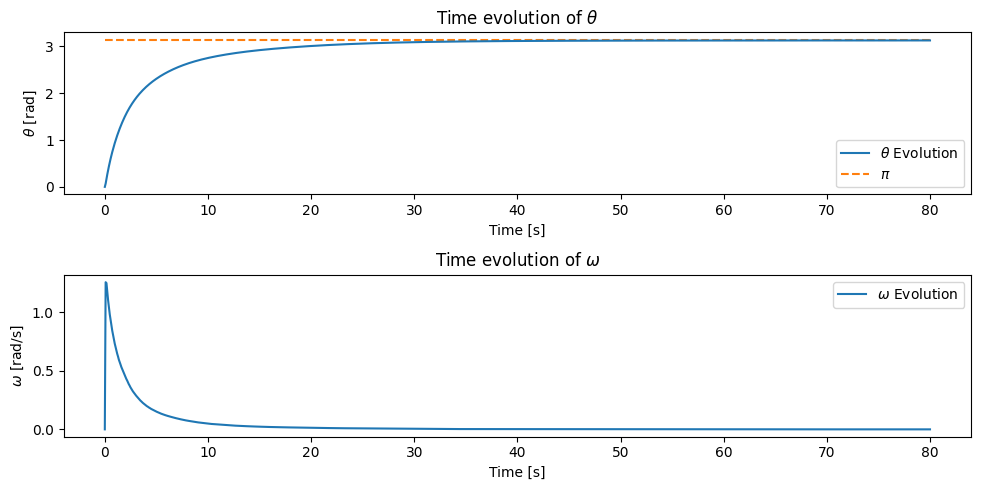

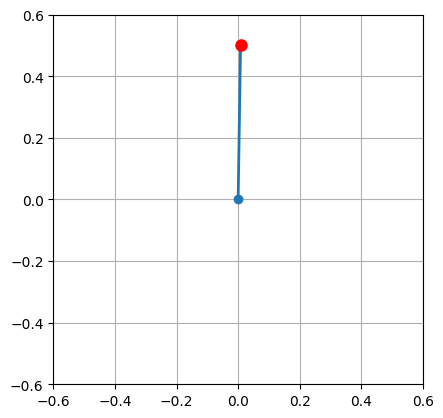

In [5]:
def learned_control(theta, omega, model):
    #theta_normalized, omega_normalized = coordinate_transformation(theta, omega)
    input_tensor = torch.tensor([[theta, omega]], dtype=torch.float32).to('cuda:0')
    control = model(input_tensor)[:, 1].item()
    return control

def inv_pendulum_dynamics(t, state, model):
    theta, omega = state
    u = learned_control(theta, omega, model)
    '''
    if omega ==0:
        u =0
    elif omega<0:
        u = -2*G*m*L*np.sin(theta+np.pi) + 1
    else:
        u =  -2*G*m*L*np.sin(theta+np.pi) - 1
    '''
    dtheta_dt = omega
    domega_dt = (-m*G*L*np.sin(theta + np.pi)-b*omega+u) / J
    return [dtheta_dt, domega_dt]
    
def update(frame):
    theta = theta_values[frame]
    x = L * np.sin(theta)
    y = -L * np.cos(theta)
    pendulum_line.set_data([0, x], [0, y])
    mass.set_data([x], [y])
    return pendulum_line, mass

load_model = True
# Initial values (in bar coordinates)
theta_0 = 0.0 - np.pi 
omega_0 = 0.0  
initial_state = [theta_0, omega_0]

# Simulation time
t_span = (0, 80)
t_eval = np.linspace(t_span[0], t_span[1], 1000)

if load_model is True:
    num_training = "00"
    model_path = f'output/Inv_pend_PINN/Inv_pend_PINN_{num_training}/model/model.pt'
    loaded_model = torch.load(model_path)
    loaded_model.eval()
    solution = solve_ivp(inv_pendulum_dynamics, t_span, initial_state, args=(loaded_model,), t_eval=t_eval, method='RK23')
else:
    solution = solve_ivp(inv_pendulum_dynamics, t_span, initial_state, args=(pendulum_model_1,), t_eval=t_eval, method='RK23')

# solutions (theta_bar = theta - pi)
theta_values = solution.y[0] + np.pi
omega_values = solution.y[1]
time_values = solution.t
print(f'Last value of theta: {theta_values[-1]:.4f}rad ({(theta_values[-1]/np.pi):.4f}pi)')
# Plot
plt.figure(figsize=(10, 5))
plt.subplot(2, 1, 1)
plt.plot(time_values, theta_values,label='$\\theta$ Evolution', zorder=3)#, label=f'$\\theta(0)=${(theta_0+np.pi):.4f}rad ({((theta_0+np.pi)/np.pi):.4f}pi); Final value={theta_values[-1]:.4f}rad ({(theta_values[-1]/np.pi):.4f}pi)')
plt.plot(time_values, np.pi * np.ones_like(theta_values),linestyle='--', label='$\\pi$',zorder=1)
plt.xlabel('Time [s]')
plt.ylabel('$\\theta$ [rad]')
plt.legend()
plt.title('Time evolution of $\\theta$')
plt.subplot(2, 1, 2)
plt.plot(time_values, omega_values,label='$\\omega$ Evolution')#, label=f'$\\omega(0)=${omega_0}; Final value={omega_values[-1]:.4f}rad/s')
plt.xlabel('Time [s]')
plt.ylabel('$\\omega$ [rad/s]')
plt.legend()
plt.title('Time evolution of $\\omega$')
plt.tight_layout()
plt.savefig(f'{figures_path}states_evolution.pdf',format="pdf")
plt.show()

# Show animation
fig, ax = plt.subplots()
ax.set_xlim(-L - 0.1, L + 0.1)
ax.set_ylim(-L - 0.1, L + 0.1)
ax.set_aspect('equal')
ax.grid()
pendulum_line, = ax.plot([], [], 'o-', lw=2)
mass, = ax.plot([], [], 'ro', markersize=8)
ani = FuncAnimation(fig, update, frames=len(time_values), interval=20, blit=True)

HTML(ani.to_jshtml())

# Find alpha value for Inverse Pendulum such that Lemma 2 holds

Building Domain Dataset
Building Validation Dataset
Learning rate: 0.0001
Epoch 1 	 Train Loss: 59.55686; 	 Valid Loss: Pos= 26.55341720581055, Deriv= 0.00000000000000, Prop= 2.64917063713074
Epoch 2 	 Train Loss: 17.86963; 	 Valid Loss: Pos= 0.00622217869386, Deriv= 0.00000000000000, Prop= 16.69460678100586
Epoch 3 	 Train Loss: 10.76880; 	 Valid Loss: Pos= 3.22537970542908, Deriv= 0.00000000000000, Prop= 5.51637792587280
Epoch 4 	 Train Loss: 6.69855; 	 Valid Loss: Pos= 0.39681723713875, Deriv= 0.00000000000000, Prop= 4.20244932174683
Epoch 5 	 Train Loss: 2.87507; 	 Valid Loss: Pos= 0.04353765398264, Deriv= 0.00000000000000, Prop= 1.07027256488800
Epoch 6 	 Train Loss: 0.50570; 	 Valid Loss: Pos= 0.01234071142972, Deriv= 0.00000000000000, Prop= 0.10881302505732
Epoch 7 	 Train Loss: 0.20161; 	 Valid Loss: Pos= 0.00692636286840, Deriv= 0.00000000000000, Prop= 0.07754254341125
Epoch 8 	 Train Loss: 0.06745; 	 Valid Loss: Pos= 0.00372037338093, Deriv= 0.00000000000000, Prop= 0.02998736

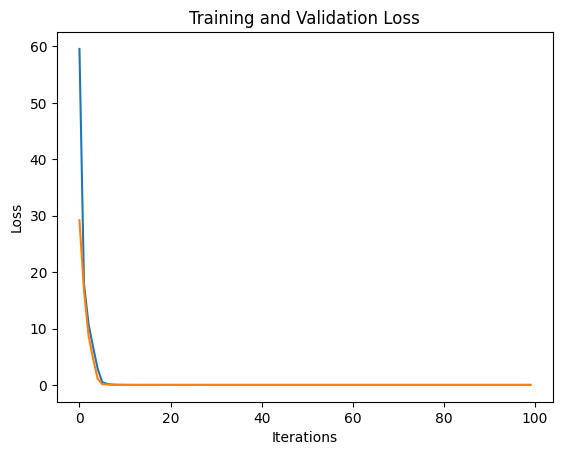

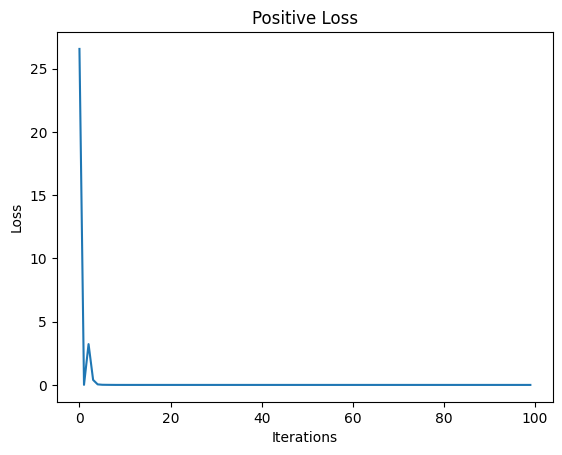

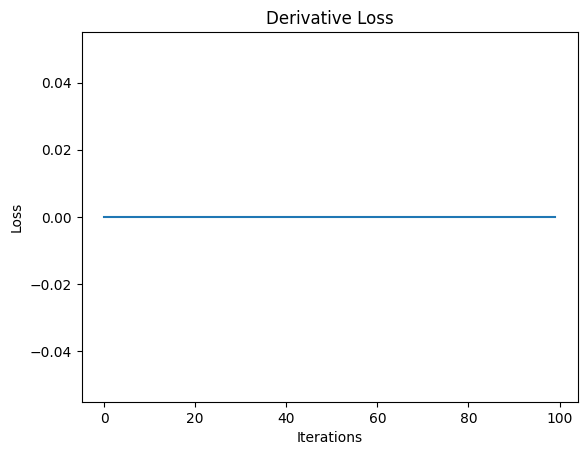

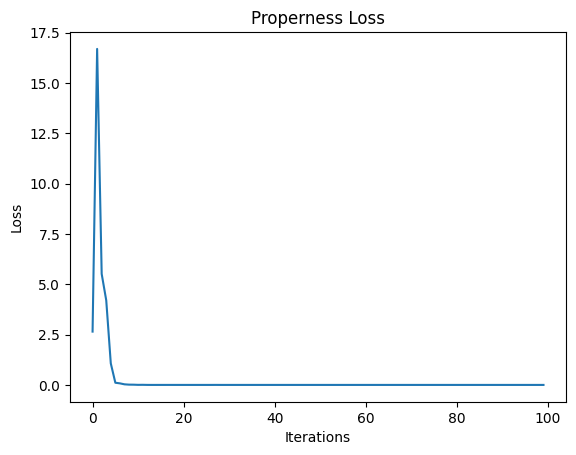

In [38]:
# Hyperparameters
epochs = 100
num_inputs = 2  # samples x1 and x2 (theta and omega [theta_dot])
num_outputs = 2 # Lyapunov V(x1,x2) and control u(x1,x2)
batchsize = 1024
num_layers = 10
num_nodes = 500
act_fn = nn.ReLU
learning_rate = 0.0001
alpha = 5/11
delta = 2
c = 1

# Build datasets
print("Building Domain Dataset")
# normalize between 0 and 1
domainDataset = DomainDataset([-np.pi]*num_inputs,[np.pi]*num_inputs, 10000, period=3)
print("Building Validation Dataset")
validationDataset = ValidationDataset([-np.pi]*num_inputs,[np.pi]*num_inputs, batchsize)

# Initialize the model, with 2 outputs (Lyapunov Function and Control)
pendulum_model_2 = PINN(
    [num_inputs] + [num_nodes]*num_layers + [num_outputs],\
    act_fn,\
    hard_constraint
).to(torch.device('cuda:0'))
pendulum_model_2 = pendulum_model_2.apply(init_normal)

# Initialize the optimizer
optimizer = optim.Adam(pendulum_model_2.parameters(), lr=learning_rate)
scheduler_reduce = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2, factor=0.8)
scheduler_step = optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)

# Use the existing train function
train_data = {
    "name": "Inv_pend_PINN",
    "model": pendulum_model_2,
    "epochs": epochs,
    "batchsize": batchsize,
    "optimizer": optimizer,
    "scheduler_step": scheduler_step,
    "scheduler_reduce": None,
    "ode_fn": inv_pendulum_ode,
    "domain_dataset": domainDataset,
    "validation_domain_dataset": validationDataset,
    "alpha": alpha,
    "delta": delta,
    "c": c,
    "positive_w": 4.0,
    "derivative_w": 0.0,
    "properness_w": 0.1,
    "check_alpha": True   # Train the PINN in order to check values of alpha that satisfy lemma 2
}
# Train the model
train(train_data)

V(0,0) = 0.0
u(0,0) = 0.010012542828917503


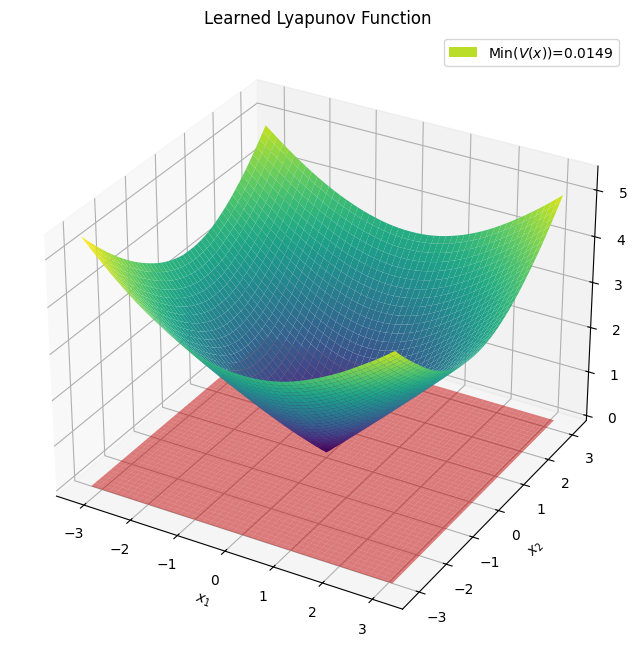

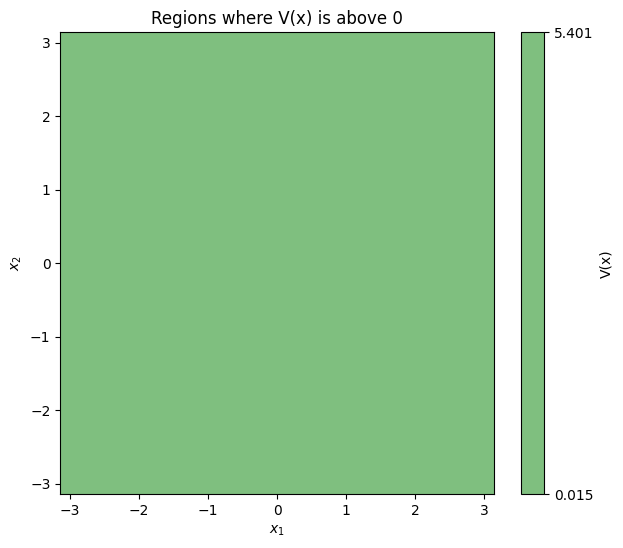

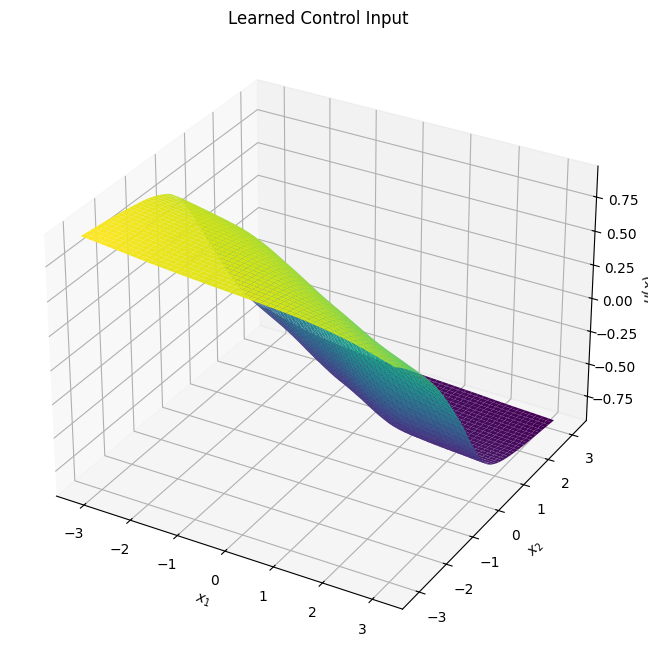

V_dot(0,0) = 0.0


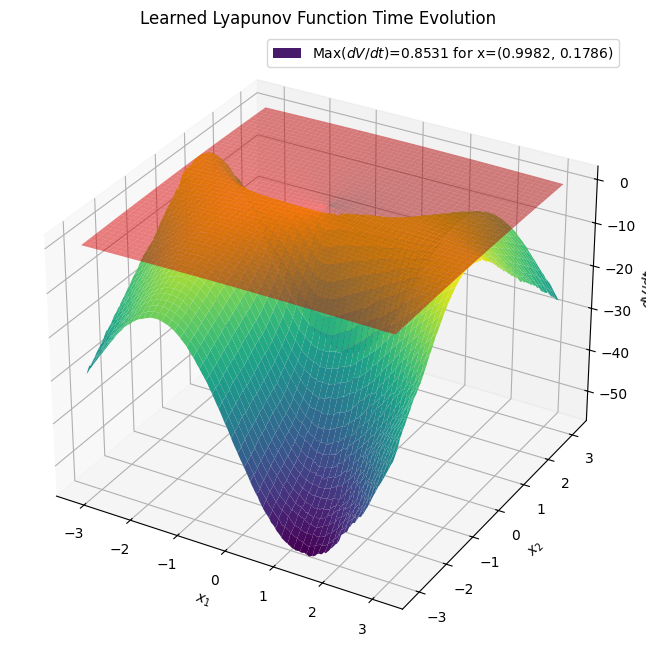

There are 8 points for which lemma 2 is not satisfied
Point (3.1416, -0.5779): V_dot = 0.2865, Constraint = 0.2837
Point (3.1206, -0.5569): V_dot = 0.2929, Constraint = 0.2900
Point (3.1416, -0.5569): V_dot = 0.3495, Constraint = 0.2846
Point (1.4815, 0.1996): V_dot = 0.7950, Constraint = 0.7938
Point (1.5025, 0.1996): V_dot = 0.7888, Constraint = 0.7860
Point (-3.1206, 0.6199): V_dot = 0.2689, Constraint = 0.2637
Point (-3.1416, 0.6409): V_dot = 0.2615, Constraint = 0.2574
Point (-3.1416, 0.6619): V_dot = 0.2691, Constraint = 0.2569


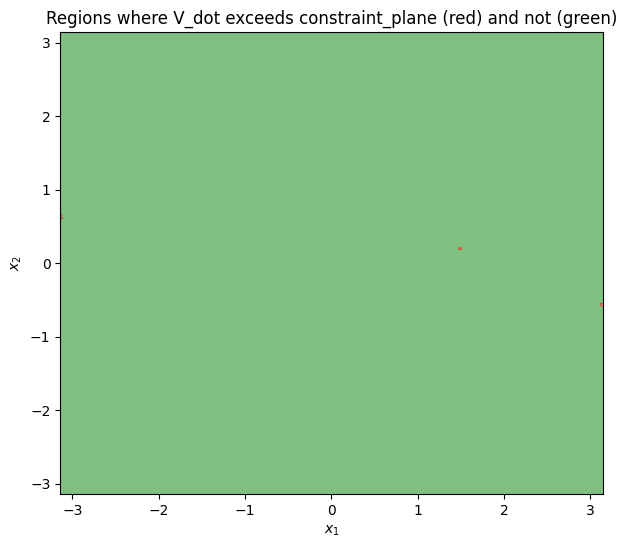

"\n# Save the plots to a zip file\nwith zipfile.ZipFile('plots.zip', 'w', zipfile.ZIP_DEFLATED) as zipf:\n    zipf.write('figures/V_3D.png', 'V_3D.png')\n    zipf.write('figures/Vdot_3D.png', 'Vdot_3D.png')\n"

In [39]:
load_model = False
figures_path = "figures/Inv_pend/Check_alpha/"
os.makedirs(figures_path, exist_ok=True)

# Generate a range of x1 and x2 values
x1_values = np.linspace(-np.pi, np.pi, 300)
x2_values = np.linspace(-np.pi, np.pi, 300)
x1_grid, x2_grid = np.meshgrid(x1_values, x2_values)
x_tensor = torch.tensor(np.column_stack((x1_grid.ravel(), x2_grid.ravel())), dtype=torch.float32, requires_grad=True).to('cuda:0')
x_0_tensor = torch.tensor([[0, 0]], dtype=torch.float32, requires_grad=True).to('cuda:0')

if load_model is True:
    num_training = 102
    model_path = f'output/Inv_pend_PINN/Inv_pend_PINN_{num_training}/model/model.pt'
    loaded_model = torch.load(model_path)
    loaded_model.eval()
    output = loaded_model(x_tensor)
    output_0 = loaded_model(x_0_tensor)
else:
    output = pendulum_model_2(x_tensor)
    output_0 = pendulum_model_2(x_0_tensor)

# Compute Lyapunov function V(x) [1st output] and corresponding value in zero
V = output[:, 0].cpu().detach().numpy().reshape(x1_grid.shape)
print(f'V(0,0) = {output_0[:,0].item()}')
V_min = np.min(V)
V_max = np.max(V)
zero_plane = np.full_like(x1_grid, 0)

# Compute Control input u [2nd output] and corresponding value in zero
control = output[:, 1].cpu().detach().numpy().reshape(x1_grid.shape)
print(f'u(0,0) = {output_0[:,1].item()}')

# Plot the learned Lyapunov function (1st output) in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x1_grid, x2_grid, V, cmap='viridis',label=f'Min($V(x)$)={V_min:.4f}')
ax.plot_surface(x1_grid, x2_grid, zero_plane, alpha=0.5, color='red')
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$V(x)$')
ax.set_title('Learned Lyapunov Function')
plt.legend()
plt.savefig(f'{figures_path}V_3D.png')
plt.show()

# 2D plot showing regions of V>0 [green] or V<0 [red]
mask = V > 0
fig = plt.figure(figsize=(7, 6))
if V_min >= 0:
    # All values are above 0, plot single color
    contour = plt.contourf(x1_grid, x2_grid, V, levels=[V_min, V_max], colors=['green'], alpha=0.5)
else:
    # Values above and below 0 exist, plot two colors
    contour = plt.contourf(x1_grid, x2_grid, V, levels=[V_min, 0, V_max], colors=['red', 'green'], alpha=0.5) 
plt.colorbar(contour, label='V(x)')
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
plt.title('Regions where V(x) is above 0')
plt.savefig(f'{figures_path}V_regions.png')
plt.show()

# Plot the learned Control (2nd output) in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x1_grid, x2_grid, control, cmap='viridis')
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$u(x)$')
ax.set_title('Learned Control Input')
plt.savefig(f'{figures_path}Control_3D.png')
plt.show()

# Compute Lie derivative of V(x) and corresponding value in zero
V_dot, lie1, lie2 = inv_pendulum_ode(output, x_tensor)
V_dot = V_dot.cpu().detach().numpy().reshape(x1_grid.shape)
V_dot_0 = inv_pendulum_ode(output_0, x_0_tensor)
print(f'V_dot(0,0) = {V_dot_0[0].item()}')
V_dot_max = np.max(V_dot)
V_dot_min = np.min(V_dot)
V_dot_argmax = np.argmax(V_dot)
x1_maximum = x1_grid.ravel()[V_dot_argmax]
x2_maximum = x2_grid.ravel()[V_dot_argmax]
constraint = -c * V**alpha + delta
constraint_plane = constraint.reshape(x2_grid.shape)

# Plot the Lie derivative of the learned Lyapunov function in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x1_grid, x2_grid, V_dot, cmap='viridis',label=f'Max($dV/dt$)={V_dot_max:.4f} for x=({x1_maximum:.4f}, {x2_maximum:.4f})')
ax.plot_surface(x1_grid, x2_grid, constraint_plane, alpha=0.5, color='red')
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$dV/dt$')
plt.legend()
ax.set_title('Learned Lyapunov Function Time Evolution')
plt.savefig(f'{figures_path}Vdot_3D.png')
plt.show()

# Check if V_dot exceeds constraint_plane and plot the regions
exceed_indices = np.where(V_dot > constraint_plane)

if exceed_indices[0].size > 0:
    print(f'There are {exceed_indices[0].size} points for which lemma 2 is not satisfied')
    if exceed_indices[0].size <=10:
        for i in range(exceed_indices[0].size):
            x1 = x1_grid[exceed_indices[0][i], exceed_indices[1][i]]
            x2 = x2_grid[exceed_indices[0][i], exceed_indices[1][i]]
            V_dot_value = V_dot[exceed_indices[0][i], exceed_indices[1][i]]
            constraint_value = constraint_plane[exceed_indices[0][i], exceed_indices[1][i]]
            print(f"Point ({x1:.4f}, {x2:.4f}): V_dot = {V_dot_value:.4f}, Constraint = {constraint_value:.4f}")
else:
    print("Lemma 2 is satisfied.")
exceed_mask = V_dot > constraint_plane
fig = plt.figure(figsize=(7, 6))
plt.contourf(x1_grid, x2_grid, exceed_mask, levels=[0, 0.5, 1], colors=['green', 'red'], alpha=0.5)
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
plt.title('Regions where V_dot exceeds constraint_plane (red) and not (green)')
plt.savefig(f'{figures_path}Vdot_regions.png')
plt.show()
'''
# Save the plots to a zip file
with zipfile.ZipFile('plots.zip', 'w', zipfile.ZIP_DEFLATED) as zipf:
    zipf.write('figures/V_3D.png', 'V_3D.png')
    zipf.write('figures/Vdot_3D.png', 'Vdot_3D.png')
'''

# Consensus for inverse pendulum

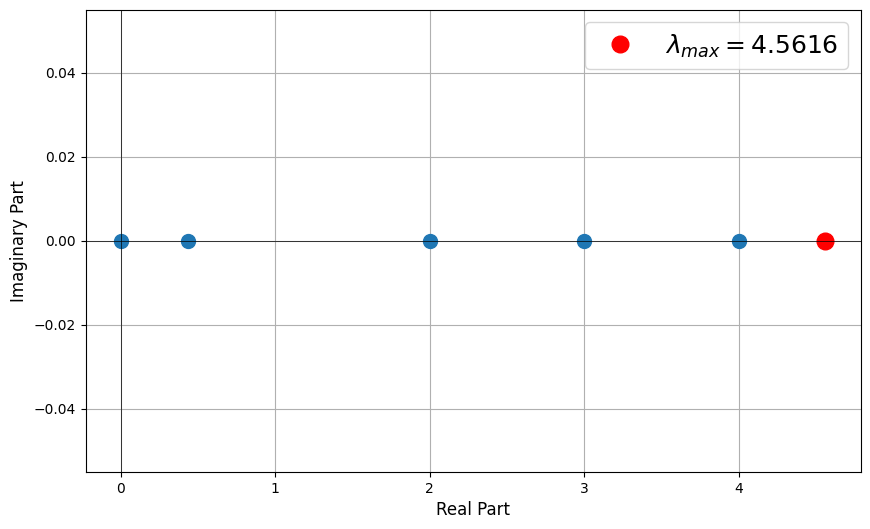

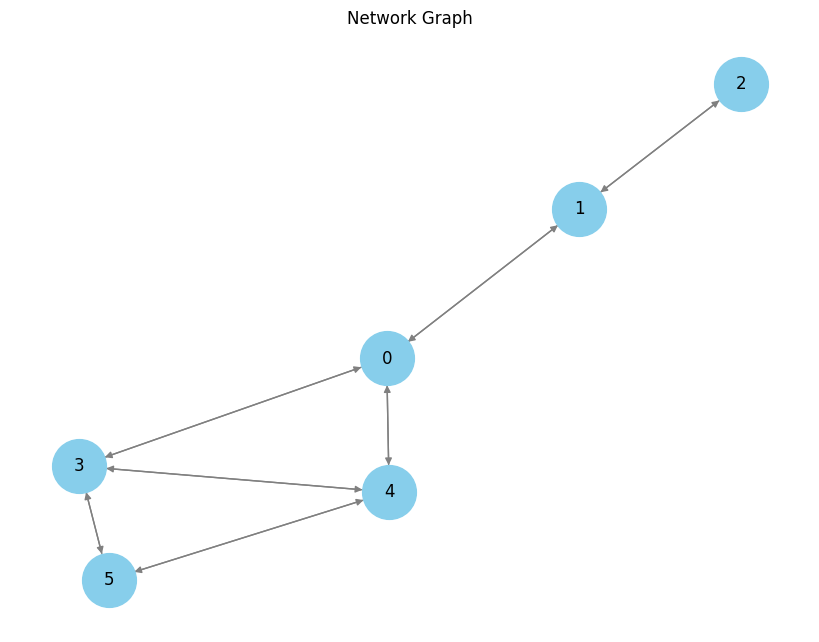

In [3]:
N = 6
def create_specific_leader_follower_graph(N):
    A = np.zeros((N, N), dtype=int)
    edges = [
        (0, 1), (0, 3), (0, 4),
        (1, 2), 
        (3, 4), (3, 5), 
        (4, 5)
    ]
    for (u, v) in edges:
        A[u][v] = 1
        A[v][u] = 1
    D = np.diag(np.sum(A, axis=1))
    L = D - A
    return A, D, L

# Example usage
A, D, L = create_specific_leader_follower_graph(N)
plot_eigenvalues(L)
plot_network(A)

In [ ]:
load_model = True
if load_model is True:
    num_training = "00"
    model_path = f'output/Inv_pend_PINN/Inv_pend_PINN_{num_training}/model/model.pt'
    model = torch.load(model_path)
    model.eval()
else:
    model = pendulum_model_1

M = 2
k1 = 3.5     # Initial gain for v_i
k2 = 1.5     # Initial gain for tanh term
alpha = 21/25  # Exponent for v_i
delta = 5.0
delta1 = 1000#delta - k2 # Saturation threshold
a0 = 0.5     # Gain for leader-following term
T = 1000     # Number of time steps
dt = 0.01    # Time step size

# Initialize the leader state
state_ranges = [((-np.pi, np.pi), (-0.1, 0.1)) for _ in range(M)]
initial_states = initialize_inv_pendulum_states(N, M, state_ranges)
for m in range(M):
    states_for_m = initial_states[:, m]
    print(f"Initialization Weights (theta) {m+1}: {states_for_m[:,0]}; expected consensus at: {np.mean(states_for_m[:,0])/np.pi}pi")
    print(f"Initialization Weights (omega) {m+1}: {states_for_m[:,1]}; expected consensus at: {np.mean(states_for_m[:,1])}rad/s")
final_state, trajectory, time_values = simulate_network(N, M, T, dt, A, k1, k2, alpha, delta1, initial_states, model)

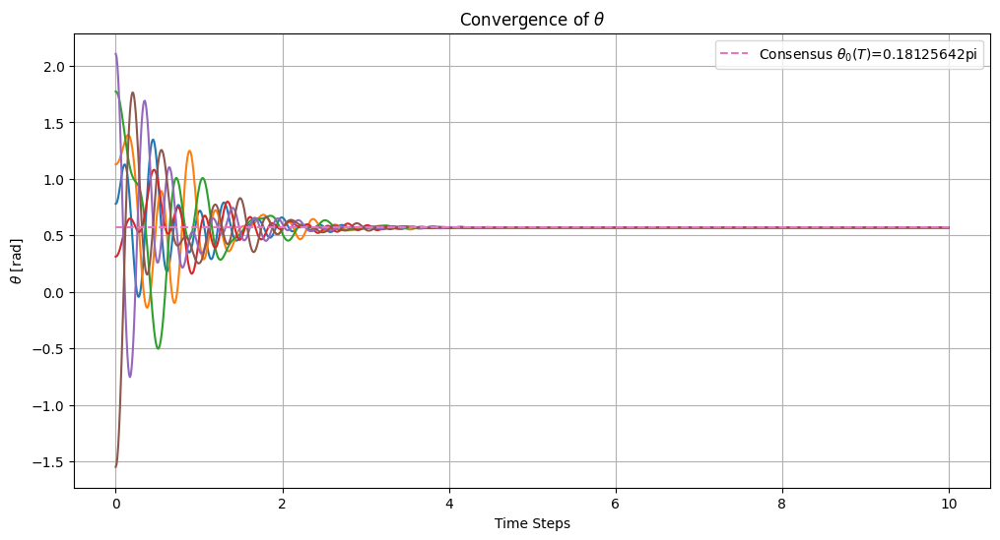

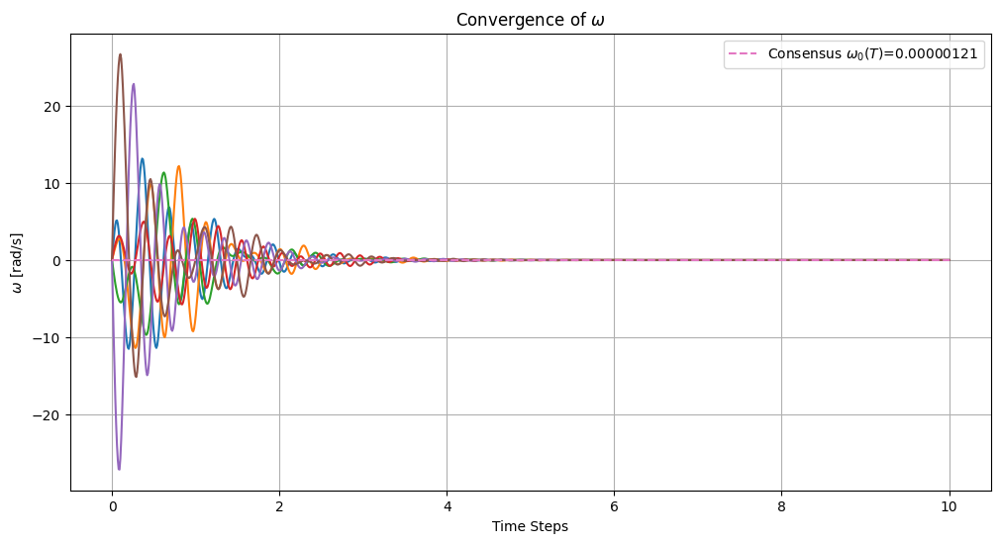

<Figure size 1200x600 with 0 Axes>

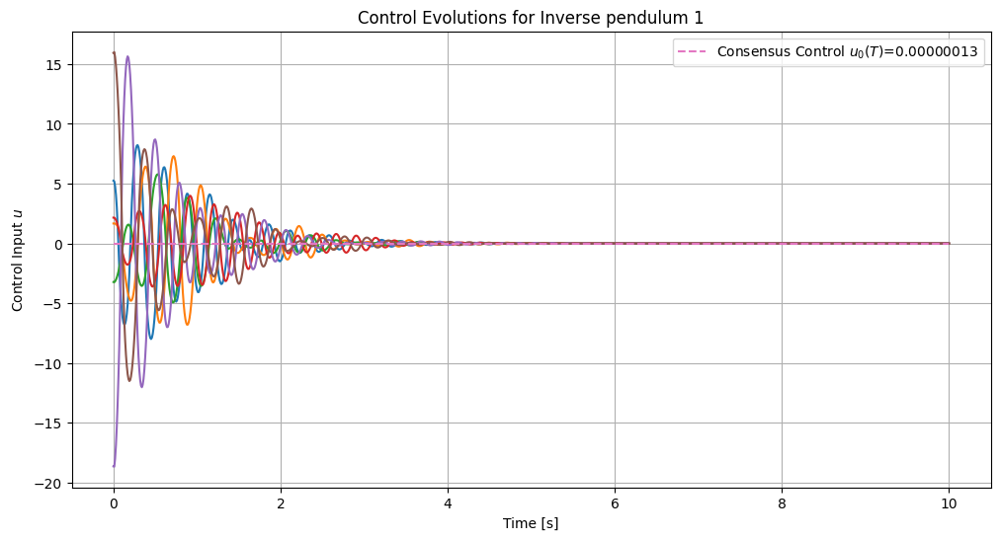

In [89]:
plot_convergence_theta(trajectory, time_values)
plot_convergence_omega(trajectory, time_values)
plot_inv_pendulum_control(trajectory, time_values)

In [96]:
# Hyperparameters
epochs = 200
num_inputs = 2  # samples x1 and x2 (theta and omega [theta_dot])
num_outputs = 2 # Lyapunov V(x1,x2) and control u(x1,x2)
batchsize = 1024
learning_rate = 0.0002830155348870433
loss_type = 'normalized'
Q = 5.0 # dVdx < -Q

# Parameters for dynamics
G = 9.81  # gravity
L = 0.5   # length of the pole
m = 0.15  # ball mass
b = 0.1   # friction
J = m * L**2 # Inertia

# Real x1 intervals (rad)
theta_max = np.pi
theta_min = -np.pi
D_theta = theta_max-theta_min

# Real x2 intervals (rad/s)
omega_max = np.pi
omega_min = -np.pi
D_omega = omega_max-omega_min

def coordinate_transformation(theta, omega):
    '''
    Transforms values in range [min,max] to values in range [0,1]
    '''
    normalized_theta = (theta - theta_min)/D_theta
    normalized_omega = (omega - omega_min)/D_omega
    return normalized_theta, normalized_omega

def inverse_coordinate_transformation(xi):
    '''
    Transforms values in range [0,1] to values in range [min,max]
    '''
    x = xi.clone()
    x[:,0] = xi[:,0]*D_theta + theta_min
    x[:,1] = xi[:,1]*D_omega + omega_min
    return x
    
# Function to enforce hard constraints
def hard_constraint(xi, y):
    # if x=0 => V(0)=0 (& dVdt(0)=0 => for a small neighborhood around zero of dVdt>-Q)
    # Proved that returns multiplications x_j * y_j for eac j= 1,...,batchsize
    # Mapping xi [0,1] -> x [min,max]
    # Apply hard constraint
    norm_x = torch.norm(xi+(theta_min/D_theta), p=2, dim=1, keepdim=True)
    V = norm_x * y[:, 0:1]
    u = y[:, 1:]
    constrained_y = torch.cat((V, u), dim=1)
    return constrained_y

# Define the ODE function for the Lyapunov constraints
def inv_pendulum_ode(pred,xi):
    device = pred.device
    
    # Mapping xi [0,1] -> x [min,max]
    x = inverse_coordinate_transformation(xi)
    
    # Compute dynamics for xi variables
    dxidt = []
    for r in range(0,len(pred)): 
        theta = xi[r][0]
        omega = xi[r][1]
        u = pred[r][1]
        f = [ 
            (omega*D_omega+omega_min) / D_theta, 
            (m*G*L*torch.sin(theta*D_theta+theta_min + np.pi) - b*(omega*D_omega+omega_min) + u) / J*D_omega 
        ]
        dxidt.append(f) 
    dxidt = torch.tensor(dxidt, device=device)
    # Add control u_bar (pred[:,1]) to the dynamics
    #dxidt[:,1] = dxidt[:,1] + (pred[:,1] / J*D_omega)

    # pred = [V_bar, u_bar]: output computed wrt samples xi
    # Find gradient of Lyapunov function V_bar wrt xi=(xi1,xi2)
    dVdxi = jacobian(pred, xi, i=0)
    
    # Lie derivative of V_bar
    lie = dVdxi[:,0]*dxidt[:,0] + dVdxi[:,1]*dxidt[:,1]
    #check_dimensions(x,pred,dxdt,lie)    
    return lie, theta_min, D_theta

def check_dimensions(x,pred,dxdt,lie):
    x_cpu = x.cpu().detach().numpy()
    y_cpu = pred.cpu().detach().numpy()
    dyn_cpu = dxdt.cpu().detach().numpy()
    lie_cpu = lie.cpu().detach().numpy()
    print(f'state shape: {x_cpu.shape}. 1st sample: ({x[0][0].item()}, {x[0][1].item()})')
    print(f'pred shape:  {y_cpu.shape}. 1st sample: ({pred[0][0].item()}, {pred[0][1].item()})')
    print(f'dynam shape: {dyn_cpu.shape}. 1st sample: ({dxdt[0][0].item()}, {dxdt[0][1].item()})')
    print(f'ode shape:   {lie_cpu.shape}.   1st sample: {lie[0].item()}')
    #for i in range(x_cpu.shape[0]):
    #    print(f"x:{x_cpu[i]}; y:{y_cpu[i]}; ode:{lie_cpu[i]}")

# Build datasets
print("Building Domain Dataset")
# normalize between 0 and 1
domainDataset = DomainDataset([0.0]*num_inputs,[1.0]*num_inputs, 10000, period=3)
print("Building Validation Dataset")
validationDataset = ValidationDataset([0.0]*num_inputs,[1.0]*num_inputs, batchsize)

# Initialize the model, with 2 outputs (Lyapunov Function and Control)
#pendulum_model = PINN([num_inputs] + [100] * 3 + [num_outputs], nn.Tanh, hard_constraint).to(torch.device('cuda:0'))
pendulum_model = PINN([num_inputs] + [469] * 4 + [num_outputs], nn.ReLU, hard_constraint).to(torch.device('cuda:0'))

# Initialize the optimizer
optimizer = optim.Adam(pendulum_model.parameters(), lr=learning_rate)
scheduler_reduce = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2, factor=0.8)
scheduler_step = optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)

# Use the existing train function
train_data = {
    "name": "Inv_pend_PINN",
    "model": pendulum_model,
    "epochs": epochs,
    "batchsize": batchsize,
    "optimizer": optimizer,
    "scheduler_step": scheduler_step,
    "scheduler_reduce": None,
    "ode_fn": inv_pendulum_ode,
    "domain_dataset": domainDataset,
    "validation_domain_dataset": validationDataset,
    "Q": Q,
    "positive_w": 1,
    "derivative_w": 1,
    "properness_w": 1,
    "normalization":True
}
# Train the model
train(train_data)

SyntaxError: invalid syntax. Perhaps you forgot a comma? (1212824775.py, line 130)

In [ ]:
def inverse_states_transformation(xi1,xi2):
    '''
    Transforms values in range [0,1] to values in range [min,max]
    '''
    x1 = xi1 * D_theta + theta_min
    x2 = xi2 * D_omega + omega_min
    return x1,x2
    
def learned_control(theta, omega, model):
    theta_normalized, omega_normalized = coordinate_transformation(theta, omega)
    input_tensor = torch.tensor([[theta_normalized, omega_normalized]], dtype=torch.float32).to('cuda:0')
    control = model(input_tensor)[:, 1].item()
    return control

# normalized system !
def inv_pendulum_dynamics(t, state, model):
    theta, omega = state
    u = learned_control(theta, omega, model)
    dtheta_dt = (omega*D_omega+omega_min)/D_theta
    domega_dt = (m*G*L*np.sin(theta*D_theta + theta_min + np.pi) - b*(omega*D_omega+omega_min) + u) / J*D_omega
    return [dtheta_dt, domega_dt]
    
def update(frame):
    theta = theta_values[frame]
    x = L * np.sin(theta)
    y = -L * np.cos(theta)
    pendulum_line.set_data([0, x], [0, y])
    mass.set_data([x], [y])
    return pendulum_line, mass

# Initial values
theta_0 = np.pi/4 
omega_0 = 0.0 
theta_bar_0, omega_bar_0 = coordinate_transformation(theta_0,omega_0)
initial_state = [theta_bar_0, omega_bar_0]

# Simulation time
t_span = (0, 10)
t_eval = np.linspace(t_span[0], t_span[1], 1000)

'''
model_path = 'output/Inv_pend_PINN/Inv_pend_PINN_13/model/model.pt'
loaded_model = torch.load(model_path)
loaded_model.eval()
solution = solve_ivp(inv_pendulum_dynamics, t_span, initial_state, args=(loaded_model,), t_eval=t_eval)
'''
solution = solve_ivp(inv_pendulum_dynamics, t_span, initial_state, args=(pendulum_model,), t_eval=t_eval)
# to anti transform
theta_bar_values = solution.y[0]
omega_bar_values = solution.y[1]
time_values = solution.t
theta_values, omega_values = inverse_states_transformation(theta_bar_values,omega_bar_values)
print(f'Last value of theta: {theta_values[-1]:.4f}rad ({(theta_values[-1]/np.pi):.4f}pi)')

# Plot
plt.figure(figsize=(10, 5))
plt.subplot(2, 1, 1)
plt.plot(time_values, theta_values, label=f'$\\theta(0)=${theta_0}; Final value={theta_values[-1]:.4f}rad ({(theta_values[-1]/np.pi):.4f}pi)')
plt.xlabel('Time [s]')
plt.ylabel('$\\theta$ [rad]')
plt.legend()
plt.title('Time evolution of $\\theta$')
plt.subplot(2, 1, 2)
plt.plot(time_values, omega_values, label=f'$\\omega(0)=${omega_0}; Final value={omega_values[-1]:.4f}rad/s')
plt.xlabel('Time [s]')
plt.ylabel('$\\omega$ [rad/s]')
plt.legend()
plt.title('Time evolution of $\\omega$')
plt.tight_layout()
plt.show()

# Show animation
fig, ax = plt.subplots()
ax.set_xlim(-L - 0.1, L + 0.1)
ax.set_ylim(-L - 0.1, L + 0.1)
ax.set_aspect('equal')
ax.grid()
pendulum_line, = ax.plot([], [], 'o-', lw=2)
mass, = ax.plot([], [], 'ro', markersize=8)
ani = FuncAnimation(fig, update, frames=len(time_values), interval=20, blit=True)

HTML(ani.to_jshtml())

V(0,0) = 0.0
u(0,0) = 0.06092628091573715


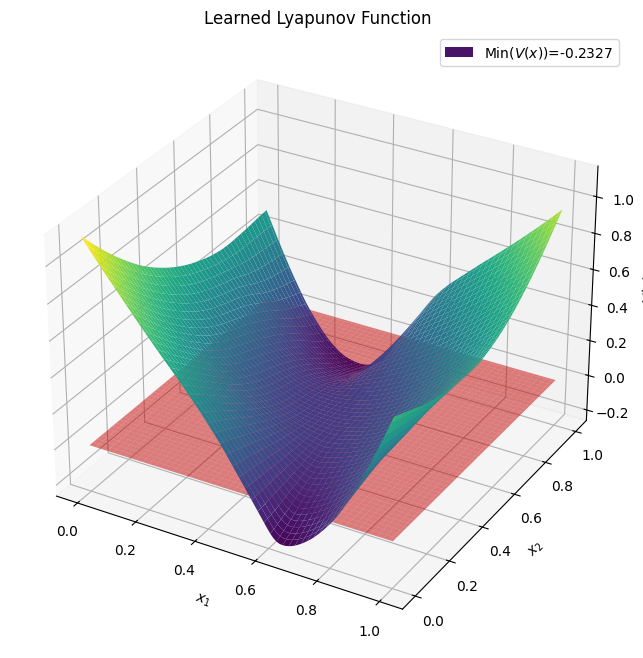

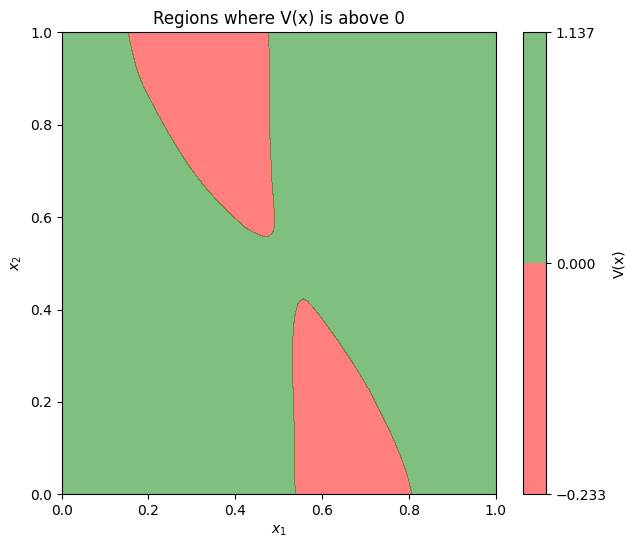

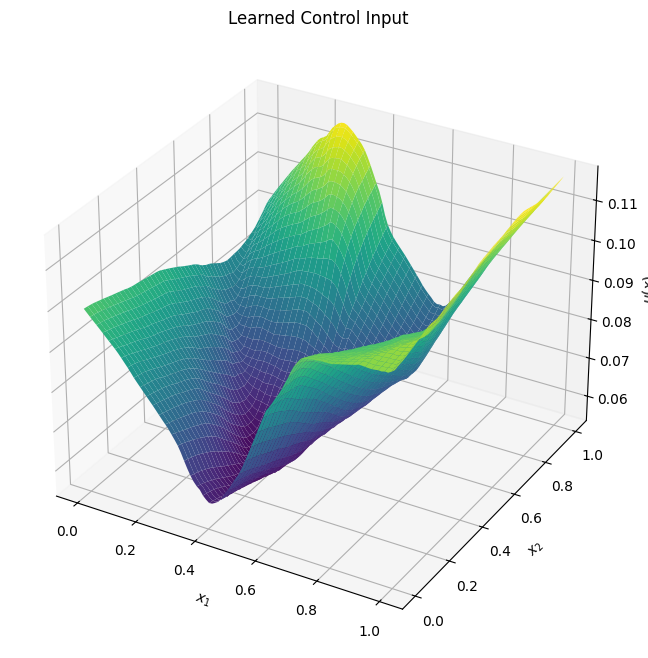

V_dot(0,0) = 0.0


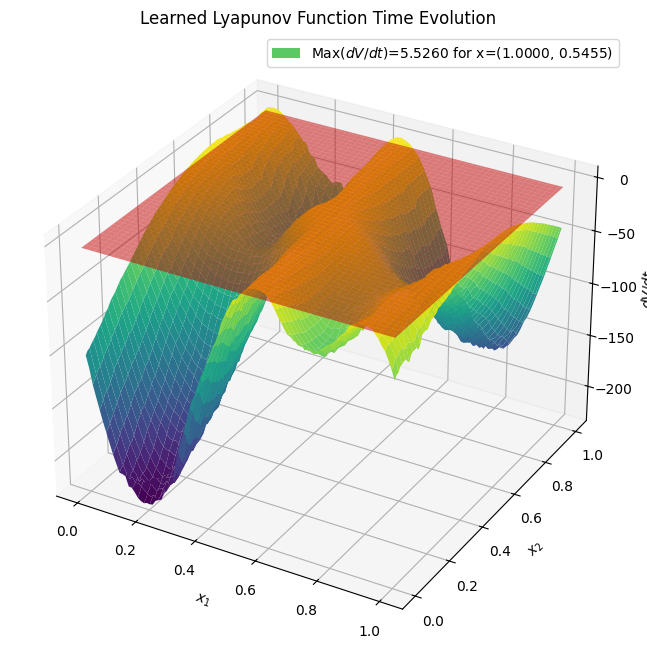

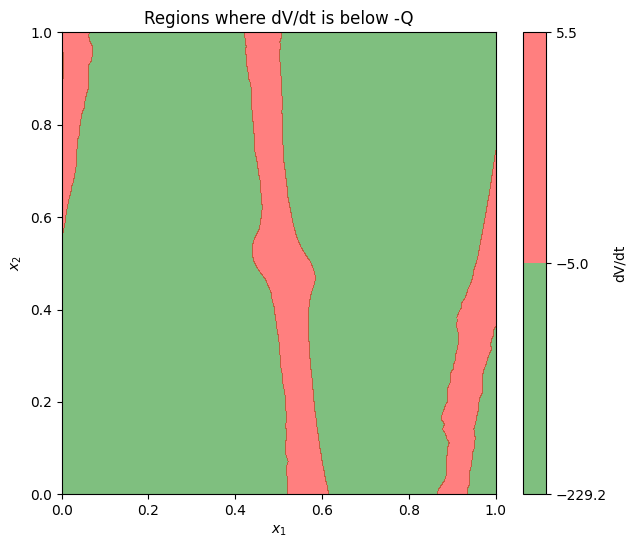

In [13]:
# Generate a range of x1 and x2 values
theta_values = np.linspace(theta_min, theta_max, 100)
omega_values = np.linspace(omega_min, omega_max, 100)
theta_grid, omega_grid = np.meshgrid(theta_values, omega_values)
theta_grid, omega_grid = coordinate_transformation(theta_grid, omega_grid)
x_tensor = torch.tensor(np.column_stack((theta_grid.ravel(), omega_grid.ravel())), dtype=torch.float32, requires_grad=True).to('cuda:0')

output = pendulum_model(x_tensor)
x_0_tensor = torch.tensor([[0.5, 0.5]], dtype=torch.float32, requires_grad=True).to('cuda:0')
output_0 = pendulum_model(x_0_tensor)

# Compute Lyapunov function V(x) [1st output] and corresponding value in zero
V = output[:, 0].cpu().detach().numpy().reshape(theta_grid.shape)
print(f'V(0,0) = {output_0[:,0].item()}')
V_min = np.min(V)
V_max = np.max(V)
zero_plane = np.full_like(theta_grid, 0)

# Compute Control input u [2nd output] and corresponding value in zero
control = output[:, 1].cpu().detach().numpy().reshape(theta_grid.shape)
print(f'u(0,0) = {output_0[:,1].item()}')

# Plot the learned Lyapunov function (1st output) in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(theta_grid, omega_grid, V, cmap='viridis',label=f'Min($V(x)$)={V_min:.4f}')
ax.plot_surface(theta_grid, omega_grid, zero_plane, alpha=0.5, color='red')
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$V(x)$')
ax.set_title('Learned Lyapunov Function')
plt.legend()
plt.savefig('figures/V_3D.png')
plt.show()

# 2D plot showing regions of V>0 [green] or V<0 [red]
mask = V > 0
fig = plt.figure(figsize=(7, 6))
if V_min >= 0:
    # All values are above 0, plot single color
    contour = plt.contourf(theta_grid, omega_grid, V, levels=[V_min, V_max], colors=['green'], alpha=0.5)
else:
    # Values above and below 0 exist, plot two colors
    contour = plt.contourf(theta_grid, omega_grid, V, levels=[V_min, 0, V_max], colors=['red', 'green'], alpha=0.5) 
plt.colorbar(contour, label='V(x)')
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
plt.title('Regions where V(x) is above 0')
plt.savefig('figures/Vdot_regions.png')
plt.show()

# Plot the learned Control (2nd output) in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(theta_grid, omega_grid, control, cmap='viridis')
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$u(x)$')
ax.set_title('Learned Control Input')
plt.savefig('figures/Control_3D.png')
plt.show()

# Compute Lie derivative of V(x) and corresponding value in zero
V_dot,lie1,lie2 = inv_pendulum_ode(output, x_tensor)
V_dot = V_dot.cpu().detach().numpy().reshape(theta_grid.shape)
V_dot_0 = inv_pendulum_ode(output_0, x_0_tensor)
print(f'V_dot(0,0) = {V_dot_0[0].item()}')
V_dot_max = np.max(V_dot)
V_dot_min = np.min(V_dot)
V_dot_argmax = np.argmax(V_dot)
theta_maximum = theta_grid.ravel()[V_dot_argmax]
omega_maximum = omega_grid.ravel()[V_dot_argmax]
Q_plane = np.full_like(theta_grid, -Q)

# Plot the Lie derivative of the learned Lyapunov function in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(theta_grid, omega_grid, V_dot, cmap='viridis',label=f'Max($dV/dt$)={V_dot_max:.4f} for x=({theta_maximum:.4f}, {omega_maximum:.4f})')
ax.plot_surface(theta_grid, omega_grid, Q_plane, alpha=0.5, color='red')
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$dV/dt$')
plt.legend()
ax.set_title('Learned Lyapunov Function Time Evolution')
plt.savefig('figures/Vdot_3D.png')
plt.show()

# 2D plot showing regions of dVdt<-Q [green] or >-Q [red]
mask = V_dot < -Q
fig = plt.figure(figsize=(7, 6))
if V_dot_max <= -Q:
    # All values are below -Q, plot single color
    contour = plt.contourf(theta_grid, omega_grid, V_dot, levels=[V_dot.min(), V_dot_max], colors=['green'], alpha=0.5)
if V_dot_min > -Q:
    # All values are over -Q, plot single color
    contour = plt.contourf(theta_grid, omega_grid, V_dot, levels=[V_dot.min(), V_dot_max], colors=['red'], alpha=0.5)
else:
    # Values above and below -Q exist, plot two colors
    contour = plt.contourf(theta_grid, omega_grid, V_dot, levels=[V_dot.min(), -Q, V_dot_max], colors=['green', 'red'], alpha=0.5)
    
plt.colorbar(contour, label='dV/dt')
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
plt.title('Regions where dV/dt is below -Q')
plt.savefig('figures/Vdot_regions.png')
plt.show()

# Save the plots to a zip file
with zipfile.ZipFile('plots.zip', 'w', zipfile.ZIP_DEFLATED) as zipf:
    zipf.write('figures/V_3D.png', 'V_3D.png')
    zipf.write('figures/Vdot_3D.png', 'Vdot_3D.png')
